In [3]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()


In [4]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

hunhtrungchin_animal_dataset_new_path = kagglehub.dataset_download('hunhtrungchin/animal-dataset-new')
hunhtrungchin_preprocessing_testing_path = kagglehub.dataset_download('hunhtrungchin/preprocessing-testing')

print('Data source import complete.')


100%|██████████| 2.97G/2.97G [02:19<00:00, 22.8MB/s]

Extracting files...


100%|██████████| 624k/624k [00:00<00:00, 759kB/s]

Extracting files...
Data source import complete.


# Applied Machine Learning - Assignment 1

This notebook focuses on training an image classification model for the animal dataset.

## A. Data Analysis

This section focuses on analyse and preprocess the data.

### 1 - Import Neccessary Packages

Notebook Colors:


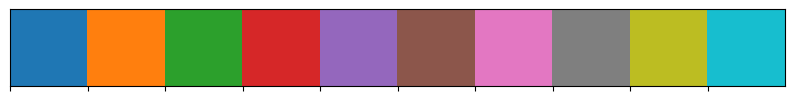

In [5]:
# Import neccessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
import random
import os
import cv2

# Import packages for training with Tensorflow and Keras
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input
from tensorflow.keras import mixed_precision
import keras_hub

# Import neccessary packages for plotting
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score


# Create the color class for better visualization during the notebook
class clr:
    # Reset
    E = "\033[0m"
    # Colors
    R = "\033[91m"   # Red
    G = "\033[92m"   # Green
    Y = "\033[93m"   # Yellow
    B = "\033[94m"   # Blue
    M = "\033[95m"   # Magenta
    C = "\033[96m"   # Cyan
    W = "\033[97m"   # White

my_colors = [
    "#1f77b4",  # blue
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#e377c2",  # pink
    "#7f7f7f",  # gray
    "#bcbd22",  # yellow-green
    "#17becf"   # cyan
]

print(clr.G+"Notebook Colors:"+clr.E)
sns.palplot(sns.color_palette(my_colors))
plt.show()

### 2 - Load the Dataset

We will first load the dataset and divided it into the train and validation dataset. First, because all the images are inside the folders belong to the class, we can use the .image_dataset_from_directory() to load the training and validation sets with the validation_split of 0.3. I will try to test for more split_sizes in the future.

In [6]:
# Define AUTOTUNE for performance optimization
AUTOTUNE = tf.data.AUTOTUNE

# Path to dataset (KaggleHub downloaded folder)
data_dir = hunhtrungchin_animal_dataset_new_path + "/train/"

# Initial train/validation split (70% train, 30% temp) ===
train_ds = image_dataset_from_directory(
    data_dir,
    validation_split=0.3,
    subset="training",
    seed=42,
    image_size=(384, 384),
    batch_size=32
)

temp_ds = image_dataset_from_directory(
    data_dir,
    validation_split=0.3,
    subset="validation",
    seed=42,
    image_size=(384, 384),
    batch_size=32
)

class_names = train_ds.class_names

# Split temp dataset (30%) into validation (20%) and test (10%)
val_size = 2 / 3   # 20% of total
test_size = 1 / 3  # 10% of total

temp_size = tf.data.experimental.cardinality(temp_ds).numpy()
val_ds = temp_ds.take(int(temp_size * val_size))
test_ds = temp_ds.skip(int(temp_size * val_size))

Found 10008 files belonging to 10 classes.
Using 7006 files for training.
Found 10008 files belonging to 10 classes.
Using 3002 files for validation.


In [7]:
print("Number of batches in training set: ", len(train_ds))
print("Number of batches in validation set: ", len(val_ds))
print("Number of batches in test set: ", len(test_ds))

Number of batches in training set:  219
Number of batches in validation set:  62
Number of batches in test set:  32


We want to plot some of the images along with their classes for testing the dataset after splitting. In order to do that, we will first get all the class names using .class_names method. After that, we will take one batch of the dataset and then plot 9 images in that batch along with their labels.

Class names: ['Amphibia', 'Animalia', 'Arachnida', 'Aves', 'Fungi', 'Insecta', 'Mammalia', 'Mollusca', 'Plantae', 'Reptilia']


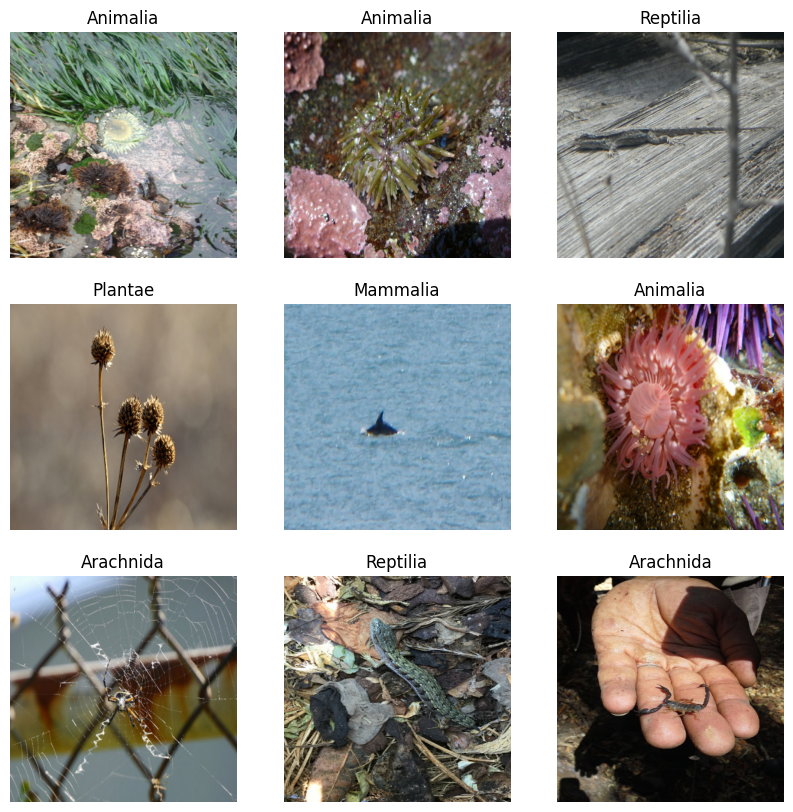

This is the chosen image for data augmentation testing!
The shape of the image is: (384, 384, 3)
The type of the label is: Arachnida


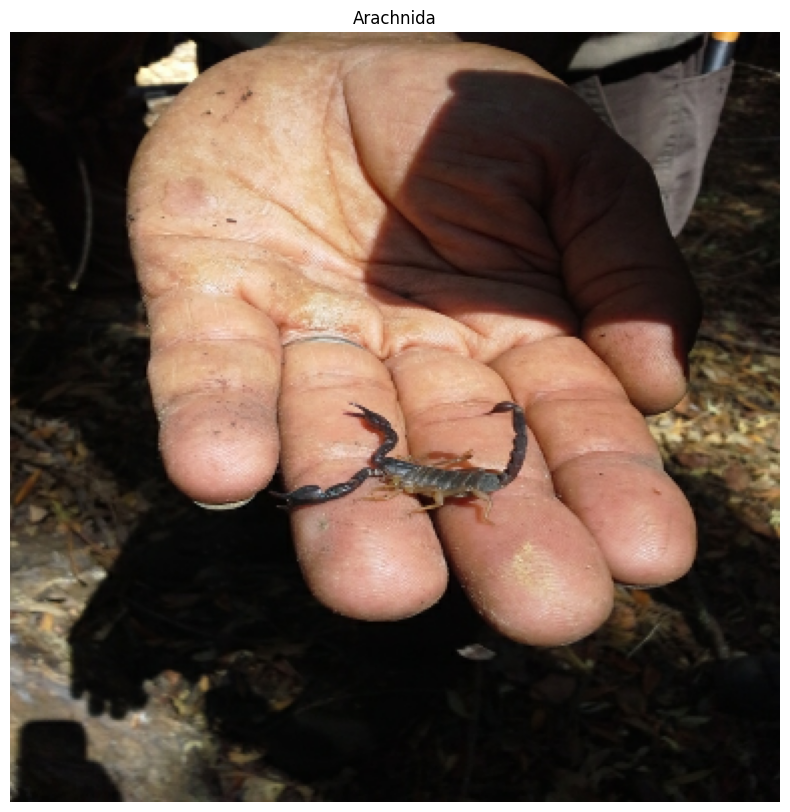

In [8]:
# Variables to store the image for augmentation visualization
img = None
img_title = None

# Get the class names
print(clr.G+"Class names:"+clr.E, class_names)

# Take one batch of images and labels
for images, labels in train_ds.take(1):
    plt.figure(figsize=(10, 10))
    for i in range(9): # show 9 images
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        label_index = labels[i].numpy()
        plt.title(class_names[label_index])
        plt.axis("off")
    img = images[i]
    img_title = class_names[label_index]
    plt.show()

# Convert the image to type "uint8" for plotting
img = img.numpy().astype("uint8")

# plot the img
print(clr.G+'This is the chosen image for data augmentation testing!'+clr.E)
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.title(img_title)
plt.axis("off")
print(clr.Y+f'The shape of the image is: {img.shape}'+clr.E)
print(clr.Y+f'The type of the label is: {img_title}'+clr.E)

### 3 - Data Preprocessing

After loading the training_set, I will perform some data preprocessing for this dataset, specifically some augmentation methods to increase the diversity of the inputs. Right now we just have 10 thousand images for each class, and the images are extremely noisy, so I will carefully test all the augmentation methods and choose the best augmentation.

#### 3.2 - Simple Data Augmentation

Now I will create an augmentation layer using tf.keras.layers. I will try multiple ways of augmenting the data to find out the most optimal one.

In [9]:
# Create a function to visualize the image before and after augmentation
def visualize(original, augmented):
    fig = plt.figure()
    plt.subplot(1,2,1)
    plt.title('Original image')
    plt.imshow(original)
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.title('Augmented image')
    plt.imshow(augmented)
    plt.axis("off")

In [10]:
# Create a data_augmentation layer for augmenting the data
data_augmentation= tf.keras.Sequential([
    tf.keras.layers.Input(shape=(384, 384, 3)),
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
    tf.keras.layers.RandomZoom(height_factor=(-0.2, 0.1), fill_mode='reflect'),
    tf.keras.layers.RandomContrast(0.2),
    tf.keras.layers.RandomBrightness(factor=0.2, value_range=(0, 255)),
])

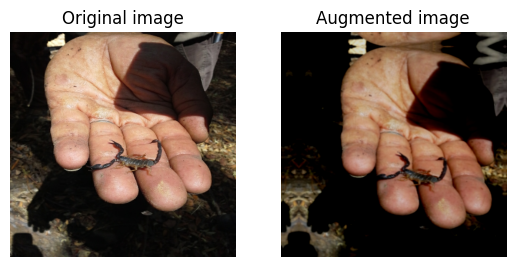

In [11]:
# Test data augmentation on the image
augmented_1 = tf.expand_dims(img, axis=0)
augmented_1 = data_augmentation(augmented_1)
augmented_1 = tf.squeeze(augmented_1)  # remove batch dim
augmented_1 = tf.clip_by_value(augmented_1, 0, 255)
augmented_img = augmented_1.numpy().astype("uint8")

# Plot the augmented image and the original image
visualize(img, augmented_img)

#### 3.3 - Advanced Data Preprocessing

This section focuses on creating some advanced data preprocessing techniques for this dataset.

##### Pairwise Channel Transfer


In [12]:
# Load two example images (target and source)
target_path = hunhtrungchin_preprocessing_testing_path + '/horse.jpg'
source_path = hunhtrungchin_preprocessing_testing_path + '/truck.jpg'

target_img = tf.io.decode_image(tf.io.read_file(target_path))
source_img = tf.io.decode_image(tf.io.read_file(source_path))

# Resize to the same shape for easy testing
target_img = tf.image.resize(target_img, (384, 384))
source_img = tf.image.resize(source_img, (384, 384))

# Convert to uint8
target_img = tf.cast(target_img, tf.uint8)
source_img = tf.cast(source_img, tf.uint8)

In [13]:
def pairwise_channel_transfer_rgb_single(target_img, source_img, alpha_range=(0.2, 0.5)):
    # If input is tensor, convert to numpy
    if isinstance(target_img, tf.Tensor):
        target = target_img.numpy().astype(np.float32)
    else:
        target = target_img.astype(np.float32)

    if isinstance(source_img, tf.Tensor):
        source = source_img.numpy().astype(np.float32)
    else:
        source = source_img.astype(np.float32)

    # Ensure both have 3 channels
    if target.ndim == 2: # add 3 channels if target shape is 2D
        target = np.stack([target]*3, axis=-1)
    elif target.shape[-1] == 1: # concatenate 3 copises for image with shape (H, W, 1)
        target = np.concatenate([target]*3, axis=-1)

    if source.ndim == 2: # add 3 channels if target shape is 2D
        source = np.stack([source]*3, axis=-1)
    elif source.shape[-1] == 1: # concatenate 3 copises for image with shape (H, W, 1)
        source = np.concatenate([source]*3, axis=-1)

    # Choose channel and blend
    ch = random.choice([0, 1, 2])  # choose R, G, or B
    alpha = random.uniform(*alpha_range) # random select the blending strength

    # Use the formula "new_channel = (1-alpha) x target_channel + alpha x source_channel"
    target[..., ch] = (1 - alpha) * target[..., ch] + alpha * source[..., ch]

    # Clip and convert back to normal image represenation
    target = np.clip(target, 0, 255).astype(np.uint8) # ensure pixel values are in range (0-255) and type uint8

    return target, ch


In [14]:
def pairwise_channel_transfer_hsv_single(target_img, source_img, alpha_range=(0.2, 0.5)):
    # If input is Tensor, convert to Numpy
    if isinstance(target_img, tf.Tensor):
        target = target_img.numpy().astype(np.float32)
    else:
        target = target_img.astype(np.float32)

    if isinstance(source_img, tf.Tensor):
        source = source_img.numpy().astype(np.float32)
    else:
        source = source_img.astype(np.float32)

    # Ensure both have 3 channels
    if target.ndim == 2: # add 3 channels if target shape is 2D
        target = np.stack([target]*3, axis=-1)
    elif target.shape[-1] == 1: # concatenate 3 copises for image with shape (H, W, 1)
        target = np.concatenate([target]*3, axis=-1)

    if source.ndim == 2: # add 3 channels if target shape is 2D
        source = np.stack([source]*3, axis=-1)
    elif source.shape[-1] == 1: # concatenate 3 copises for image with shape (H, W, 1)
        source = np.concatenate([source]*3, axis=-1)

    # Convert to [0,1]
    target = target / 255.0
    source = source / 255.0

    # Convert to HSV
    target_hsv = tf.image.rgb_to_hsv(target)
    source_hsv = tf.image.rgb_to_hsv(source)

    # Randomly choose a channel (0=H, 1=S, 2=V)
    ch = random.choice([0, 1, 2])
    alpha = random.uniform(*alpha_range) # randomly choose the blending strength

    # Blend one channel
    target_hsv_np = target_hsv.numpy()
    source_hsv_np = source_hsv.numpy()
    target_hsv_np[..., ch] = (1 - alpha) * target_hsv_np[..., ch] + alpha * source_hsv_np[..., ch]

    # Convert back to RGB
    result_rgb = tf.image.hsv_to_rgb(target_hsv_np)
    result_rgb = tf.clip_by_value(result_rgb * 255.0, 0, 255)
    result_rgb = tf.cast(result_rgb, tf.uint8).numpy()

    return result_rgb, ch


Transferred RGB channel: Blue


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27 () missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


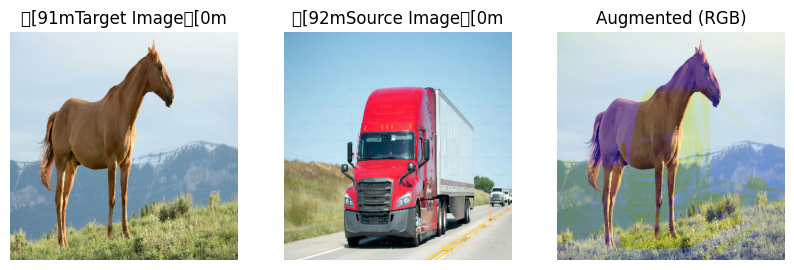

In [15]:
# Test pairwise channel transfer on the test images
aug_rgb, ch_rgb = pairwise_channel_transfer_rgb_single(target_img, source_img)
print(f"Transferred RGB channel: {[clr.R+'Red'+clr.E, clr.G+'Green'+clr.E, clr.B+'Blue'+clr.E][ch_rgb]}")

plt.figure(figsize=(10, 4))
plt.subplot(1, 3, 1)
plt.title(clr.R+"Target Image"+clr.E)
plt.imshow(target_img.numpy().astype(np.uint8))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title(clr.G+"Source Image"+clr.E)
plt.imshow(source_img.numpy().astype(np.uint8))
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Augmented (RGB)")
plt.imshow(aug_rgb)
plt.axis('off')
plt.show()


Transferred HSV channel: Value


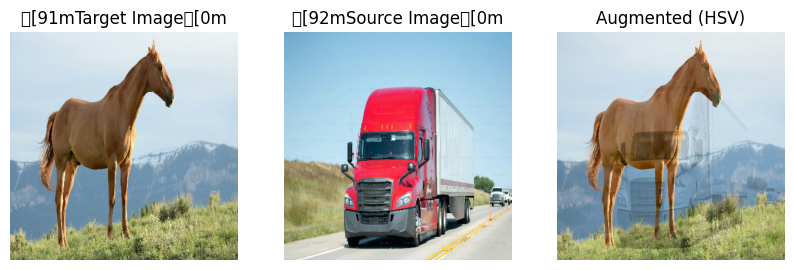

In [16]:
aug_hsv, ch_hsv = pairwise_channel_transfer_hsv_single(target_img, source_img)
print(f"Transferred HSV channel: {['Hue','Saturation','Value'][ch_hsv]}")

plt.figure(figsize=(10, 4))
plt.subplot(1, 3, 1)
plt.title(clr.R+"Target Image"+clr.E)
plt.imshow(target_img.numpy().astype(np.uint8))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title(clr.G+"Source Image"+clr.E)
plt.imshow(source_img.numpy().astype(np.uint8))
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Augmented (HSV)")
plt.imshow(aug_hsv)
plt.axis('off')
plt.show()


In [17]:
# Apply pairwise channel to the dataset and save it
def save_pairwise_augmented_dataset_separate(dataset, source_dataset_dir, save_dir_rgb, save_dir_hsv, class_names):

    # make the two directories for rgb and hsv transfer
    os.makedirs(save_dir_rgb, exist_ok=True)
    os.makedirs(save_dir_hsv, exist_ok=True)

    # List all source images
    source_images_paths = []
    for root, _, files in os.walk(source_dataset_dir):
        for f in files:
            if f.lower().endswith(('.png', '.jpg', '.jpeg')):
                source_images_paths.append(os.path.join(root, f))
    if len(source_images_paths) == 0:
        raise ValueError("No source images found in directory.")

    idx_rgb = 0
    idx_hsv = 0

    for batch_images, batch_labels in dataset:
        batch_images_np = batch_images.numpy().astype(np.uint8)
        batch_labels_np = batch_labels.numpy()

        for i in range(batch_images_np.shape[0]):
            target_img = batch_images_np[i]
            label_idx = int(batch_labels_np[i])
            class_name = class_names[label_idx] # convert labels to classnames

            # Pick a random source image
            source_path = random.choice(source_images_paths)
            source_img = tf.io.decode_image(tf.io.read_file(source_path))
            source_img = tf.image.resize(source_img, (384, 384))
            source_img = tf.cast(source_img, tf.uint8).numpy()

            # RGB augmentation
            aug_rgb, _ = pairwise_channel_transfer_rgb_single(target_img, source_img)
            class_dir_rgb = os.path.join(save_dir_rgb, class_name)
            os.makedirs(class_dir_rgb, exist_ok=True)
            save_path_rgb = os.path.join(class_dir_rgb, f"aug_{idx_rgb}.jpg")
            tf.keras.utils.save_img(save_path_rgb, aug_rgb)
            idx_rgb += 1

            # HSV augmentation
            aug_hsv, _ = pairwise_channel_transfer_hsv_single(target_img, source_img)
            class_dir_hsv = os.path.join(save_dir_hsv, class_name)
            os.makedirs(class_dir_hsv, exist_ok=True)
            save_path_hsv = os.path.join(class_dir_hsv, f"aug_{idx_hsv}.jpg")
            tf.keras.utils.save_img(save_path_hsv, aug_hsv)
            idx_hsv += 1

    print(clr.G+f"RGB augmented dataset saved at: "+clr.E, save_dir_rgb)
    print(clr.G+f"HSV augmented dataset saved at: "+clr.E, save_dir_hsv)


In [18]:
save_pairwise_augmented_dataset_separate(
    train_ds,
    source_dataset_dir=data_dir,
    save_dir_rgb="augmented_rgb",
    save_dir_hsv="augmented_hsv",
    class_names=class_names
)


RGB augmented dataset saved at:  augmented_rgb
HSV augmented dataset saved at:  augmented_hsv


##### Random Object Occlusion
    Perform Random Object Occlusion by placing the occluder
    strictly in one of the four corners,ensuring it's far from
    the image center.

In [19]:
def random_object_occlusion_safe(target_img, source_img, occlusion_size=(100,100), safe_zone_ratio=0.5):

    # Ensure both are uint8 numpy arrays
    if isinstance(target_img, tf.Tensor):
        target_img = target_img.numpy().astype(np.uint8)
    else:
        target_img = target_img.astype(np.uint8)

    if isinstance(source_img, tf.Tensor):
        source_img = source_img.numpy().astype(np.uint8)
    else:
        source_img = source_img.astype(np.uint8)

    target_np = target_img.copy()
    h, w, _ = target_np.shape # get the height and with of the target
    oh, ow = occlusion_size # get the chosen occlusion size

    # Resize occluder
    occluder = tf.image.resize(source_img, occlusion_size).numpy().astype(np.uint8)

    # Define corner coordinates
    corners = [
        (0, 0),                              # top-left
        (0, w - ow),                         # top-right
        (h - oh, 0),                         # bottom-left
        (h - oh, w - ow)                     # bottom-right
    ]

    # Randomly choose one of the 4 corners
    top, left = random.choice(corners)

    # Overlay the occluder
    alpha = random.uniform(0.6, 1.0)
    target_np[top:top+oh, left:left+ow, :] = (
        alpha * occluder + (1 - alpha) * target_np[top:top+oh, left:left+ow, :]
    ).astype(np.uint8)

    return target_np, (top, left)


Occluder placed at: (0, 0)


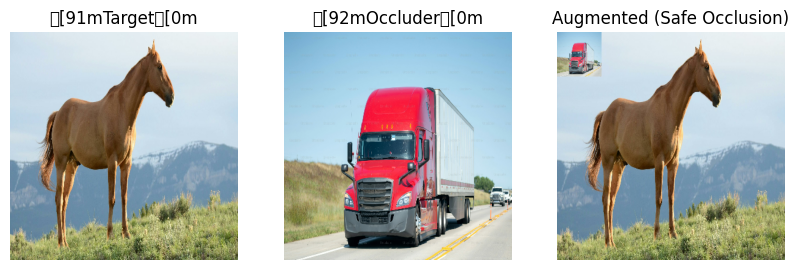

In [20]:
# Test random occlusion on the test image
aug_img, pos = random_object_occlusion_safe(target_img, source_img, occlusion_size=(75,75))
print(f"Occluder placed at: {pos}")

plt.figure(figsize=(10,4))
plt.subplot(1,3,1)
plt.title(clr.R+"Target"+clr.E)
plt.imshow(target_img.numpy().astype(np.uint8))
plt.axis('off')

plt.subplot(1,3,2)
plt.title(clr.G+"Occluder"+clr.E)
plt.imshow(source_img.numpy().astype(np.uint8))
plt.axis('off')

plt.subplot(1,3,3)
plt.title("Augmented (Safe Occlusion)")
plt.imshow(aug_img)
plt.axis('off')
plt.show()


In [21]:
def save_random_object_occlusion_safe_dataset(dataset, source_dataset_dir, save_dir, class_names,
                                              occlusion_size=(75,75), safe_zone_ratio=0.5):

    # Create a directory for saving the images
    os.makedirs(save_dir, exist_ok=True)

    # List all source images
    source_images_paths = []
    for root, _, files in os.walk(source_dataset_dir):
        for f in files:
            if f.lower().endswith(('.png', '.jpg', '.jpeg')):
                source_images_paths.append(os.path.join(root, f))
    if len(source_images_paths) == 0:
        raise ValueError("No source images found in source directory.")

    idx = 0
    for batch_images, batch_labels in dataset:
        batch_images_np = batch_images.numpy().astype(np.uint8)
        batch_labels_np = batch_labels.numpy()

        for i in range(batch_images_np.shape[0]):
            target_img = batch_images_np[i]
            label = batch_labels_np[i]

            # Pick random source image for occluder
            source_path = random.choice(source_images_paths)
            source_img = tf.io.decode_image(tf.io.read_file(source_path))
            source_img = tf.image.resize(source_img, (384, 384))
            source_img = tf.cast(source_img, tf.uint8).numpy()

            # Apply safe occlusion
            aug_img, _ = random_object_occlusion_safe(
                target_img, source_img,
                occlusion_size=occlusion_size,
                safe_zone_ratio=safe_zone_ratio
            )

            # Save in class-name folder
            class_name = class_names[label]
            class_dir = os.path.join(save_dir, class_name)
            os.makedirs(class_dir, exist_ok=True)

            save_path = os.path.join(class_dir, f"aug_{idx}.jpg")
            tf.keras.utils.save_img(save_path, aug_img)
            idx += 1

    print(clr.G+f"Safe Random Object Occlusion dataset saved at: "+clr.E, save_dir)


In [22]:
safe_occlusion_train_dir = "/content/augmented_occlusion"

save_random_object_occlusion_safe_dataset(
    dataset=train_ds,
    source_dataset_dir=data_dir,
    save_dir=safe_occlusion_train_dir,
    class_names=class_names,
    occlusion_size=(75,75),
    safe_zone_ratio=0.5
)


Safe Random Object Occlusion dataset saved at:  /content/augmented_occlusion


##### Novel masking augmentaton

    Apply novel masking augmentation with *thinner* line width:
    vertical, horizontal, checkered, or circular rings.
  

In [23]:
def novel_masking_augmentation(img, mask_type="vertical", mask_color=(0, 0, 0), num_stripes=24):

    # Convert to numpy if type is Tensor
    if isinstance(img, tf.Tensor):
        img = img.numpy()
    img = img.copy().astype(np.uint8)
    h, w, _ = img.shape
    mask_color = np.array(mask_color, dtype=np.uint8)
    mask = np.zeros((h, w), dtype=bool)

    # Vertical Stripes
    if mask_type == "vertical":
        stripe_width = max(1, w // (num_stripes * 6))  # define the stripe witdh
        for i in range(0, w, stripe_width * 2):
            mask[:, i:i + stripe_width] = True

    # Horizontal Stripes
    elif mask_type == "horizontal":
        stripe_height = max(1, h // (num_stripes * 6))  # define the stripe height
        for i in range(0, h, stripe_height * 2):
            mask[i:i + stripe_height, :] = True

    # Checkered Pattern
    elif mask_type == "checkered":
        cell_h = max(1, h // (num_stripes * 6))
        cell_w = max(1, w // (num_stripes * 6))
        for i in range(0, h, cell_h * 2):
            for j in range(0, w, cell_w * 2):
                mask[i:i + cell_h, j:j + cell_w] = True
        for i in range(cell_h, h, cell_h * 2):
            for j in range(cell_w, w, cell_w * 2):
                mask[i:i + cell_h, j:j + cell_w] = True

    # Circular Rings
    elif mask_type == "circular":
        center = (h // 2, w // 2)
        max_radius = math.sqrt(center[0]**2 + center[1]**2)
        ring_thickness = max_radius / (num_stripes * 8)
        y, x = np.ogrid[:h, :w]
        dist = np.sqrt((x - center[1])**2 + (y - center[0])**2)

        for i in range(num_stripes):
            inner_r = i * (max_radius / num_stripes)
            outer_r = inner_r + ring_thickness
            ring = (dist >= inner_r) & (dist < outer_r)
            mask[ring] = True

    # Apply mask
    img[mask] = mask_color

    return img


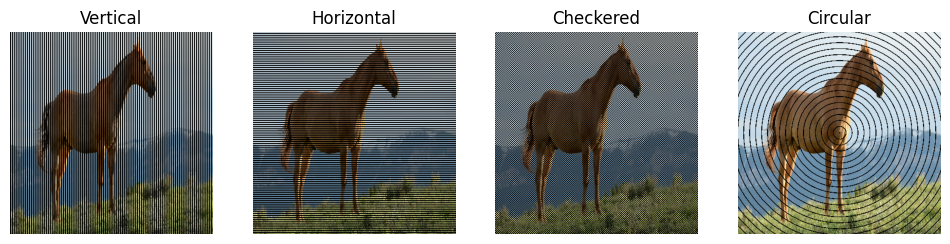

In [24]:
# Load test image
img_path = hunhtrungchin_preprocessing_testing_path + '/horse.jpg'
img = tf.io.decode_image(tf.io.read_file(img_path))
img = tf.image.resize(img, (384, 384))
img = tf.cast(img, tf.uint8)

# Apply each mask type
mask_types = ["vertical", "horizontal", "checkered", "circular"]
plt.figure(figsize=(12,6))

for i, m in enumerate(mask_types):
    masked_img = novel_masking_augmentation(img, mask_type=m)
    plt.subplot(1, 4, i+1)
    plt.title(m.capitalize())
    plt.imshow(masked_img)
    plt.axis('off')

plt.show()

In [25]:
def save_novel_masking_dataset_random(dataset, save_dir, class_names,
                                      mask_color=(0,0,0), num_stripes=24):
    # Create a directory to save the images
    os.makedirs(save_dir, exist_ok=True)
    idx = 0
    mask_types = ["vertical", "horizontal", "checkered", "circular"]

    for batch_images, batch_labels in dataset:
        batch_images_np = batch_images.numpy().astype(np.uint8)
        batch_labels_np = batch_labels.numpy()

        for i in range(batch_images_np.shape[0]):
            img = batch_images_np[i]
            label = batch_labels_np[i]

            # Pick a random mask type
            mask_type = random.choice(mask_types)

            # Apply novel masking augmentation
            aug_img = novel_masking_augmentation(img, mask_type=mask_type,
                                                 mask_color=mask_color, num_stripes=num_stripes)

            # Save in class-name folder
            class_name = class_names[label]
            class_dir = os.path.join(save_dir, class_name)
            os.makedirs(class_dir, exist_ok=True)

            save_path = os.path.join(class_dir, f"aug_{idx}.jpg")
            tf.keras.utils.save_img(save_path, aug_img)
            idx += 1

    print(clr.G+f"Novel masking (random types) dataset saved at: "+clr.E, save_dir)


In [26]:
novel_mask_train_dir = "/content/augmented_masking"

save_novel_masking_dataset_random(
    dataset=train_ds,
    save_dir=novel_mask_train_dir,
    class_names=class_names,
    mask_color=(0,0,0),  # black stripes
    num_stripes=24
)


Novel masking (random types) dataset saved at:  /content/augmented_masking


##### Standard Augmentation

In [27]:
def standard_augmentations(img):
    aug_type = random.choice([
        "rotation", "horizontal_flip",
        "resize", "translation", "blur", "color_jitter", "random_erasing"
    ])
    img_np = img.numpy().astype(np.uint8)

    if aug_type == "rotation":
        angle = random.randint(0, 45)
        h, w = img_np.shape[:2]
        M = cv2.getRotationMatrix2D((w//2, h//2), angle, 1)
        img_np = cv2.warpAffine(img_np, M, (w, h))

    elif aug_type == "horizontal_flip":
        img_np = cv2.flip(img_np, 1)

    elif aug_type == "resize":
        img_np = cv2.resize(img_np, (384, 384))

    elif aug_type == "translation":
        dx, dy = random.randint(-40, 40), random.randint(-40, 40)
        M = np.float32([[1, 0, dx], [0, 1, dy]])
        h, w = img_np.shape[:2]
        img_np = cv2.warpAffine(img_np, M, (w, h))

    elif aug_type == "blur":
        k = random.choice([3, 5])
        img_np = cv2.GaussianBlur(img_np, (k, k), 0)

    elif aug_type == "color_jitter":
        # Random brightness/contrast shift
        hsv = cv2.cvtColor(img_np, cv2.COLOR_RGB2HSV)
        hsv = np.array(hsv, dtype=np.float32)
        hsv[...,1] *= random.uniform(0.7, 1.3)
        hsv[...,2] *= random.uniform(0.7, 1.3)
        hsv = np.clip(hsv, 0, 255).astype(np.uint8)
        img_np = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)

    elif aug_type == "random_erasing":
        h, w = img_np.shape[:2]
        erase_w, erase_h = random.randint(20, 60), random.randint(20, 60)
        x, y = random.randint(0, w - erase_w), random.randint(0, h - erase_h)
        img_np[y:y+erase_h, x:x+erase_w, :] = np.random.randint(0, 256, (erase_h, erase_w, 3), dtype=np.uint8)

    return img_np, aug_type

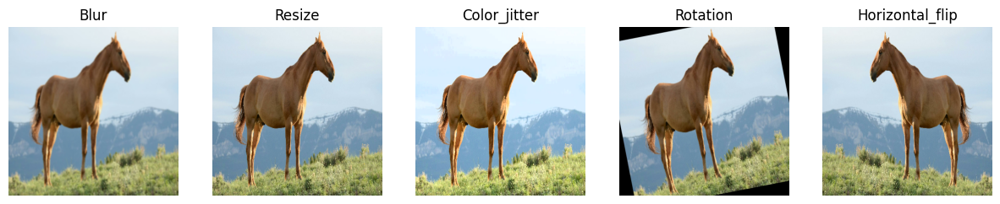

In [28]:
# Load one sample image
img_path = hunhtrungchin_preprocessing_testing_path + '/horse.jpg'
img = tf.io.decode_image(tf.io.read_file(img_path))
img = tf.image.resize(img, (384, 384))
img = tf.cast(img, tf.uint8)

# Apply each augmentation type
augmentations = [
    "rotation", "hflip", "vflip", "color_jitter", "random_erasing"
]

plt.figure(figsize=(15,6))
for i, aug in enumerate(augmentations):
    aug_img, aug_type = standard_augmentations(img)
    plt.subplot(1, len(augmentations), i+1)
    plt.title(aug_type.capitalize())
    plt.imshow(aug_img)
    plt.axis("off")

plt.show()

In [29]:
def save_standard_augmentations_dataset(dataset, save_dir, class_names):

    # Create a directory for saving the images
    os.makedirs(save_dir, exist_ok=True)
    idx = 0

    for batch_images, batch_labels in dataset:
        batch_images_np = batch_images.numpy().astype(np.uint8)
        batch_labels_np = batch_labels.numpy()

        for i in range(batch_images_np.shape[0]):
            img = batch_images_np[i]
            label = batch_labels_np[i]

            # Apply standard augmentation
            aug_img, aug_type = standard_augmentations(tf.convert_to_tensor(img))

            # Save in class-name folder
            class_name = class_names[label]
            class_dir = os.path.join(save_dir, class_name)
            os.makedirs(class_dir, exist_ok=True)

            save_path = os.path.join(class_dir, f"aug_{idx}_{aug_type}.jpg")
            tf.keras.utils.save_img(save_path, aug_img)
            idx += 1

    print(clr.G+f"Standard augmentation dataset saved at: "+clr.E, save_dir)

In [30]:
standard_aug_train_dir = "/content/augmented_standard"

save_standard_augmentations_dataset(
    dataset=train_ds,
    save_dir=standard_aug_train_dir,
    class_names=class_names
)


Standard augmentation dataset saved at:  /content/augmented_standard


##### Combining to create train dataset

In [31]:
# Create a function to load the augmented_dataset
def load_augmented_dataset(folder_path, img_size=(384, 384), batch_size=16, shuffle=True):
    ds = tf.keras.preprocessing.image_dataset_from_directory(
        folder_path,
        image_size=img_size,
        batch_size=batch_size,
        shuffle=shuffle
    )
    ds = ds.prefetch(tf.data.AUTOTUNE)
    return ds


In [32]:
# Paths where you saved each augmentation
rgb_dir = "/content/augmented_rgb"
hsv_dir = "/content/augmented_hsv"
safe_occlusion_dir = "/content/augmented_occlusion"
novel_mask_dir = "/content/augmented_masking"
standard_aug_dir = "/content/augmented_standard"

# Load as tf.data.Dataset
rgb_ds = load_augmented_dataset(rgb_dir, batch_size=32)
hsv_ds = load_augmented_dataset(hsv_dir, batch_size=32)
safe_occlusion_ds = load_augmented_dataset(safe_occlusion_dir, batch_size=32)
novel_mask_ds = load_augmented_dataset(novel_mask_dir, batch_size=32)
standard_ds = load_augmented_dataset(standard_aug_dir, batch_size=32)

Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.


In [33]:
datasets = [
    train_ds,
    rgb_ds,
    hsv_ds,
    safe_occlusion_ds,
    novel_mask_ds,
    standard_ds
]

# Start with the first one
all_aug_ds_32 = datasets[0]

# Concatenate the rest sequentially
for ds in datasets[1:]:
    all_aug_ds_32 = all_aug_ds_32.concatenate(ds)

In [34]:
print(clr.Y+"BATCH SIZE = 32"+clr.E)
print(clr.G+"Number of batches in rgb_ds: "+clr.E, len(rgb_ds))
print(clr.G+"Number of batches in hsv_ds: "+clr.E, len(hsv_ds))
print(clr.G+"Number of batches in safe_occlusion_ds: "+clr.E, len(safe_occlusion_ds))
print(clr.G+"Number of batches novel_mask_ds: "+clr.E, len(novel_mask_ds))
print(clr.G+"Number of batches standard_ds: "+clr.E, len(standard_ds))
print(clr.G+"Number of batches all_aug_ds: "+clr.E, len(all_aug_ds_32))

BATCH SIZE = 32
Number of batches in rgb_ds:  219
Number of batches in hsv_ds:  219
Number of batches in safe_occlusion_ds:  219
Number of batches novel_mask_ds:  219
Number of batches standard_ds:  219
Number of batches all_aug_ds:  1314


In [35]:
# Load with batchsize = 16
rgb_ds = load_augmented_dataset(rgb_dir, batch_size=16)
hsv_ds = load_augmented_dataset(hsv_dir, batch_size=16)
safe_occlusion_ds = load_augmented_dataset(safe_occlusion_dir, batch_size=16)
novel_mask_ds = load_augmented_dataset(novel_mask_dir, batch_size=16)
standard_ds = load_augmented_dataset(standard_aug_dir, batch_size=16)

datasets = [
    train_ds,
    rgb_ds,
    hsv_ds,
    safe_occlusion_ds,
    novel_mask_ds,
    standard_ds
]

# Start with the first one
all_aug_ds_16 = datasets[0]

# Concatenate the rest sequentially
for ds in datasets[1:]:
    all_aug_ds_16 = all_aug_ds_16.concatenate(ds)

Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.
Found 7006 files belonging to 10 classes.


In [36]:
print(clr.Y+"\nBATCH SIZE = 16"+clr.E)
print(clr.G+"Number of batches in rgb_ds: "+clr.E, len(rgb_ds))
print(clr.G+"Number of batches in hsv_ds: "+clr.E, len(hsv_ds))
print(clr.G+"Number of batches in safe_occlusion_ds: "+clr.E, len(safe_occlusion_ds))
print(clr.G+"Number of batches novel_mask_ds: "+clr.E, len(novel_mask_ds))
print(clr.G+"Number of batches standard_ds: "+clr.E, len(standard_ds))
print(clr.G+"Number of batches all_aug_ds: "+clr.E, len(all_aug_ds_16))


BATCH SIZE = 16
Number of batches in rgb_ds:  438
Number of batches in hsv_ds:  438
Number of batches in safe_occlusion_ds:  438
Number of batches novel_mask_ds:  438
Number of batches standard_ds:  438
Number of batches all_aug_ds:  2409


## B. Baseline Convolution

This section focuses on building a simple CNN model to very first test the performance of the baseline model on the dataset.

As the architecture of a CNN model, the height, width will reduce overtime, while the number of channels will increase. Moreover, I stack 2 **Conv2D** layers to help the model to learn more features. This is just a simple model, so the accuracy after training might not very high.

Because this is just a simple model, so I will use the Sequential API.

#### 1. Build a simple CNN

In [37]:
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
from tensorflow.keras.layers import Input, Add, Dense, Activation, ZeroPadding2D, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalAveragePooling2D, BatchNormalization, Dropout
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras import datasets, layers, models, Sequential

In [38]:
# Create a simple CNN model
baseline_model = models.Sequential( # Using Sequential API for simplicity
    [
        layers.Input(shape=(384, 384, 3)),
        data_augmentation,
        layers.Rescaling(1./255),

        # --- Block 1 ---
        layers.Conv2D(32, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(32, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),

        # --- Block 2 ---
        layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.3),

        # --- Block 3 ---
        layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.4),

        # --- Block 4 ---
        layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.4),

        # # --- Block 5 ---
        # layers.Conv2D(512, (3, 3), padding='same', activation='relu'),
        # layers.BatchNormalization(),
        # layers.Conv2D(512, (3, 3), padding='same', activation='relu'),
        # layers.BatchNormalization(),
        # layers.MaxPooling2D((2, 2)),
        # layers.Dropout(0.4),

        # # --- Block 6 ---
        # layers.Conv2D(1024, (3, 3), padding='same', activation='relu'),
        # layers.BatchNormalization(),
        # layers.Conv2D(1024, (3, 3), padding='same', activation='relu'),
        # layers.BatchNormalization(),
        layers.GlobalAveragePooling2D(),
        layers.Dropout(0.5),
    ]
)

In [39]:
# Check for the summary of the model
baseline_model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential (Sequential)         │ (None, 384, 384, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling (Rescaling)           │ (None, 384, 384, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 384, 384, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 384, 384, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 384, 384, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 384, 384, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 192, 192, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 192, 192, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 192, 192, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 192, 192, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 192, 192, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 192, 192, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 96, 96, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 96, 96, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 96, 96, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 96, 96, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 96, 96, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 96, 96, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 48, 48, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 48, 48, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 48, 48, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 48, 48, 256)    │         1,02

 Total params: 1,176,096 (4.49 MB)

 Trainable params: 1,174,176 (4.48 MB)

 Non-trainable params: 1,920 (7.50 KB)

In [40]:
# Add Dense layers after flatten, with the final dense layers to give 10 outputs (10 classes)
baseline_model.add(layers.Dense(128, activation='relu'))
baseline_model.add(layers.BatchNormalization())
baseline_model.add(layers.Dropout(0.5))
baseline_model.add(layers.Dense(10, activation='softmax'))

In [41]:
# Check the model summary one more time, this is the complete architecture
baseline_model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential (Sequential)         │ (None, 384, 384, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling (Rescaling)           │ (None, 384, 384, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 384, 384, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 384, 384, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 384, 384, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 384, 384, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 192, 192, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 192, 192, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 192, 192, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 192, 192, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 192, 192, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 192, 192, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 96, 96, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 96, 96, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 96, 96, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 96, 96, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 96, 96, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 96, 96, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 48, 48, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 48, 48, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 48, 48, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 48, 48, 256)    │         1,02

 Total params: 1,210,794 (4.62 MB)

 Trainable params: 1,208,618 (4.61 MB)

 Non-trainable params: 2,176 (8.50 KB)

#### 4.2 - Compile and train the model

In [42]:
# Create early stopping to optimize training time and reduce overfitting
early_stop = EarlyStopping(
    monitor="val_loss",   # Stop if validation loss stops improving
    patience=15,          # Allow some patience
    restore_best_weights=True,  # Roll back to the best model
    verbose=1
)

In [43]:

# Create reducing LR on Plateau
reduce_lr = ReduceLROnPlateau(
    monitor="val_loss",   # Watch validation loss
    factor=0.5,           # Reduce LR by half
    patience=5,           # Wait 5 epochs before reducing
    min_lr=1e-6,          # Don’t let LR go below this
    verbose=1
)

In [44]:
# Create optimizer SGD and train the model
opt = tf.keras.optimizers.Adam(learning_rate=0.001)
loss = tf.keras.losses.SparseCategoricalCrossentropy()

baseline_model.compile(optimizer=opt, loss=loss, metrics=['accuracy'])

baseline_history = baseline_model.fit(
    train_ds,
    epochs=20,
    validation_data=val_ds,
    callbacks=[early_stop, reduce_lr], # Include early_stop and reduce_lr
    verbose=1
)

Epoch 1/20
219/219 ━━━━━━━━━━━━━━━━━━━━ 70s 226ms/step - accuracy: 0.1349 - loss: 3.0545 - val_accuracy: 0.1079 - val_loss: 2.3482 - learning_rate: 0.0010
Epoch 2/20
219/219 ━━━━━━━━━━━━━━━━━━━━ 36s 165ms/step - accuracy: 0.1500 - loss: 2.5516 - val_accuracy: 0.1326 - val_loss: 2.3197 - learning_rate: 0.0010
Epoch 3/20
219/219 ━━━━━━━━━━━━━━━━━━━━ 36s 165ms/step - accuracy: 0.1612 - loss: 2.3935 - val_accuracy: 0.2228 - val_loss: 2.2318 - learning_rate: 0.0010
Epoch 4/20
219/219 ━━━━━━━━━━━━━━━━━━━━ 36s 165ms/step - accuracy: 0.2015 - loss: 2.2799 - val_accuracy: 0.2273 - val_loss: 2.1988 - learning_rate: 0.0010
Epoch 5/20
219/219 ━━━━━━━━━━━━━━━━━━━━ 36s 165ms/step - accuracy: 0.2039 - loss: 2.2396 - val_accuracy: 0.2324 - val_loss: 2.1565 - learning_rate: 0.0010
Epoch 6/20
219/219 ━━━━━━━━━━━━━━━━━━━━ 36s 165ms/step - accuracy: 0.2209 - loss: 2.1657 - val_accuracy: 0.2500 - val_loss: 2.0902 - learning_rate: 0.0010
Epoch 7/20
219/219 ━━━━━━━━━━━━━━━━━━━━ 36s 166ms/step - accuracy: 0.2

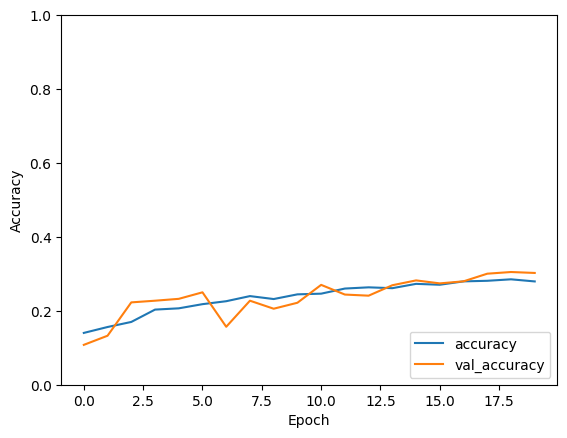

In [45]:
# Plot the learning curve
plt.plot(baseline_history.history['accuracy'], label='accuracy')
plt.plot(baseline_history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.0, 1])
plt.legend(loc='lower right')

## C. Transfer Learning

This section focuses on using a simple transfer learning to test the performance on the dataset using EfficientNet.

### 1 - EfficientNet with Original Dataset and Augmentation Layer

#### 1.1 - Create the base model

In [46]:
# Base model (EfficientNetV2B0)
efficientnet_model_v1 = tf.keras.applications.EfficientNetV2B0(
    include_top=False,
    weights="imagenet",
    input_shape=(384, 384, 3)
)

efficientnet_model_v1.trainable = False  # freeze base model for feature extraction

24274472/24274472 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


#### 1.2 - Build the model

In [47]:
# Build the model with data augmentation layer
inputs = layers.Input(shape=(384, 384, 3))
x = data_augmentation(inputs)  # Apply data augmentation
x = tf.keras.applications.efficientnet.preprocess_input(x)
x = efficientnet_model_v1(x, training=False)

# Multi-stage pooling (capture both average)
x = layers.GlobalAveragePooling2D()(x)

# Dense block with high regularization
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.5)(x)

x = layers.Dense(512, activation="relu")(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.4)(x)

x = layers.Dense(256, activation="relu")(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.3)(x)

outputs = layers.Dense(len(class_names), activation="softmax")(x)
model_v1 = Model(inputs, outputs)

#### 1.3 - Compile the model

In [48]:
# Create optimizer SGD and train the model
opt = tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9)
loss = tf.keras.losses.SparseCategoricalCrossentropy()

model_v1.compile(optimizer=opt, loss=loss, metrics=['accuracy'])

#### 1.4 - Feature Extraction

In [49]:
# Create early_stopping and learning rate decay
early_stop = EarlyStopping(monitor="val_loss", patience=8, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-6)

# Train the model (Feature Extraction Phase)
fe_history_v1 = model_v1.fit(
    train_ds,
    validation_data=val_ds,
    epochs=10,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

Epoch 1/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 29s 71ms/step - accuracy: 0.2989 - loss: 2.3838 - val_accuracy: 0.7727 - val_loss: 0.8550 - learning_rate: 0.0010
Epoch 2/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 12s 54ms/step - accuracy: 0.6153 - loss: 1.2023 - val_accuracy: 0.8135 - val_loss: 0.5779 - learning_rate: 0.0010
Epoch 3/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 12s 53ms/step - accuracy: 0.6707 - loss: 1.0410 - val_accuracy: 0.8241 - val_loss: 0.5354 - learning_rate: 0.0010
Epoch 4/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 12s 53ms/step - accuracy: 0.6954 - loss: 0.9472 - val_accuracy: 0.8251 - val_loss: 0.5214 - learning_rate: 0.0010
Epoch 5/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 12s 53ms/step - accuracy: 0.7005 - loss: 0.9247 - val_accuracy: 0.8276 - val_loss: 0.5087 - learning_rate: 0.0010
Epoch 6/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 12s 53ms/step - accuracy: 0.7131 - loss: 0.9026 - val_accuracy: 0.8357 - val_loss: 0.4974 - learning_rate: 0.0010
Epoch 7/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 12s 54ms/step - accuracy: 0.7242 - l

#### 1.5 - Fine tuning

In [50]:
# Fine-tuning phase
efficientnet_model_v1.trainable = True
for layer in efficientnet_model_v1.layers[:-70]:  # freeze all but top 70 layers
    layer.trainable = False

# Compile again with a lower LR for fine-tuning
model_v1.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

efficientnet_model_v1_history = model_v1.fit(
    train_ds,
    validation_data=val_ds,
    epochs=50,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

Epoch 1/50
219/219 ━━━━━━━━━━━━━━━━━━━━ 42s 92ms/step - accuracy: 0.6733 - loss: 0.9826 - val_accuracy: 0.8286 - val_loss: 0.5175 - learning_rate: 1.0000e-05
Epoch 2/50
219/219 ━━━━━━━━━━━━━━━━━━━━ 17s 77ms/step - accuracy: 0.6822 - loss: 0.9535 - val_accuracy: 0.8322 - val_loss: 0.4995 - learning_rate: 1.0000e-05
Epoch 3/50
219/219 ━━━━━━━━━━━━━━━━━━━━ 17s 77ms/step - accuracy: 0.7070 - loss: 0.8971 - val_accuracy: 0.8327 - val_loss: 0.4912 - learning_rate: 1.0000e-05
Epoch 4/50
219/219 ━━━━━━━━━━━━━━━━━━━━ 17s 77ms/step - accuracy: 0.7057 - loss: 0.8943 - val_accuracy: 0.8387 - val_loss: 0.4793 - learning_rate: 1.0000e-05
Epoch 5/50
219/219 ━━━━━━━━━━━━━━━━━━━━ 17s 76ms/step - accuracy: 0.7268 - loss: 0.8390 - val_accuracy: 0.8397 - val_loss: 0.4721 - learning_rate: 1.0000e-05
Epoch 6/50
219/219 ━━━━━━━━━━━━━━━━━━━━ 17s 77ms/step - accuracy: 0.7357 - loss: 0.8015 - val_accuracy: 0.8392 - val_loss: 0.4703 - learning_rate: 1.0000e-05
Epoch 7/50
219/219 ━━━━━━━━━━━━━━━━━━━━ 17s 77ms/ste

#### 1.6 - Plotting

In [51]:
# Plot training history
def plot_history(histories, titles=["Feature Extraction", "Fine-tuning"]):
    plt.figure(figsize=(12,5))
    for i, history in enumerate(histories):
        plt.subplot(1,2,1)
        plt.plot(history.history["accuracy"], label=f"Train Acc ({titles[i]})")
        plt.plot(history.history["val_accuracy"], label=f"Val Acc ({titles[i]})")
        plt.title("Accuracy")
        plt.legend()

        plt.subplot(1,2,2)
        plt.plot(history.history["loss"], label=f"Train Loss ({titles[i]})")
        plt.plot(history.history["val_loss"], label=f"Val Loss ({titles[i]})")
        plt.title("Loss")
        plt.legend()


    plt.show()

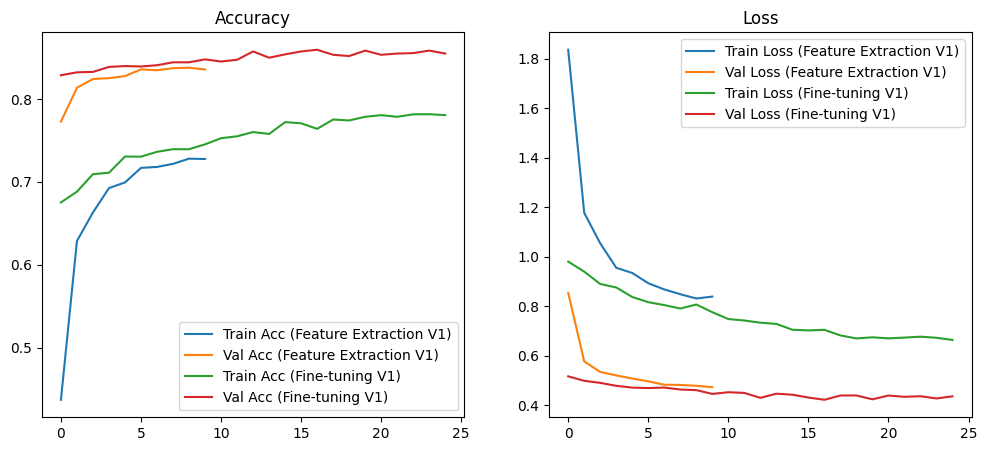

In [52]:
# Plot training history
plot_history([fe_history_v1, efficientnet_model_v1_history],
             titles=["Feature Extraction V1", "Fine-tuning V1"])

### 2 - EfficientNet with Advanced Dataset

#### 2.1 - Create the base model

In [53]:
# Base model (EfficientNetV2B0)
efficientnet_model_v2 = tf.keras.applications.EfficientNetV2B0(
    include_top=False,
    weights="imagenet",
    input_shape=(384, 384, 3)
)

efficientnet_model_v2.trainable = False  # freeze base model for feature extraction

#### 2.2 - Build the model

In [54]:
# Build the model
inputs = layers.Input(shape=(384, 384, 3))
x = tf.keras.applications.efficientnet.preprocess_input(inputs)
x = efficientnet_model_v2(x, training=False)

# Multi-stage pooling (capture both average)
x = layers.GlobalAveragePooling2D()(x)

# Dense block with high regularization
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.5)(x)

x = layers.Dense(512, activation="relu")(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.4)(x)

x = layers.Dense(256, activation="relu")(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.3)(x)

outputs = layers.Dense(len(class_names), activation="softmax")(x)
model = Model(inputs, outputs)


#### 2.3 - Compile the model

In [55]:
# Create optimizer SGD and train the model
opt = tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9)
loss = tf.keras.losses.SparseCategoricalCrossentropy()

model.compile(optimizer=opt, loss=loss, metrics=['accuracy'])

#### 2.4 - Feature Extraction

In [56]:
# Create early_stopping and learning rate decay
early_stop = EarlyStopping(monitor="val_loss", patience=8, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-6)

# Train the model (Feature Extraction Phase)
fe_history_v2 = model.fit(
    all_aug_ds_32,
    validation_data=val_ds,
    epochs=10,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

Epoch 1/10
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 112s 54ms/step - accuracy: 0.5342 - loss: 1.5090 - val_accuracy: 0.8347 - val_loss: 0.4967 - learning_rate: 0.0010
Epoch 2/10
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 32s 24ms/step - accuracy: 0.7192 - loss: 0.8697 - val_accuracy: 0.8407 - val_loss: 0.4793 - learning_rate: 0.0010
Epoch 3/10
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 32s 24ms/step - accuracy: 0.7426 - loss: 0.7958 - val_accuracy: 0.8498 - val_loss: 0.4593 - learning_rate: 0.0010
Epoch 4/10
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 31s 24ms/step - accuracy: 0.7539 - loss: 0.7559 - val_accuracy: 0.8518 - val_loss: 0.4547 - learning_rate: 0.0010
Epoch 5/10
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 31s 24ms/step - accuracy: 0.7593 - loss: 0.7423 - val_accuracy: 0.8488 - val_loss: 0.4458 - learning_rate: 0.0010
Epoch 6/10
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 31s 24ms/step - accuracy: 0.7679 - loss: 0.7189 - val_accuracy: 0.8473 - val_loss: 0.4416 - learning_rate: 0.0010
Epoch 7/10
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 32s 24ms/step - accur

#### 2.5 - Fine tuning

In [59]:
# Fine-tune the model
efficientnet_model_v2.trainable = True
for layer in efficientnet_model_v2.layers[:-70]:
    layer.trainable = False

# Recompile the full model with lower learning rate
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# Fine-tune training
fine_tune_history_v2 = model.fit(
    all_aug_ds_32,
    validation_data=val_ds,
    epochs=50,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)

Epoch 1/50
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 116s 55ms/step - accuracy: 0.7438 - loss: 0.7937 - val_accuracy: 0.8569 - val_loss: 0.4282 - learning_rate: 1.0000e-05
Epoch 2/50
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - accuracy: 0.7709 - loss: 0.7062 - val_accuracy: 0.8579 - val_loss: 0.4236 - learning_rate: 1.0000e-05
Epoch 3/50
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - accuracy: 0.7806 - loss: 0.6800 - val_accuracy: 0.8629 - val_loss: 0.4067 - learning_rate: 1.0000e-05
Epoch 4/50
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - accuracy: 0.7968 - loss: 0.6370 - val_accuracy: 0.8594 - val_loss: 0.4113 - learning_rate: 1.0000e-05
Epoch 5/50
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - accuracy: 0.8018 - loss: 0.6172 - val_accuracy: 0.8674 - val_loss: 0.3966 - learning_rate: 1.0000e-05
Epoch 6/50
1314/1314 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - accuracy: 0.8104 - loss: 0.5889 - val_accuracy: 0.8624 - val_loss: 0.4029 - learning_rate: 1.0000e-05
Epoch 7/50
1314/1314 ━━━━━━━━━━━━━━━━━━

#### 2.6 - Plotting

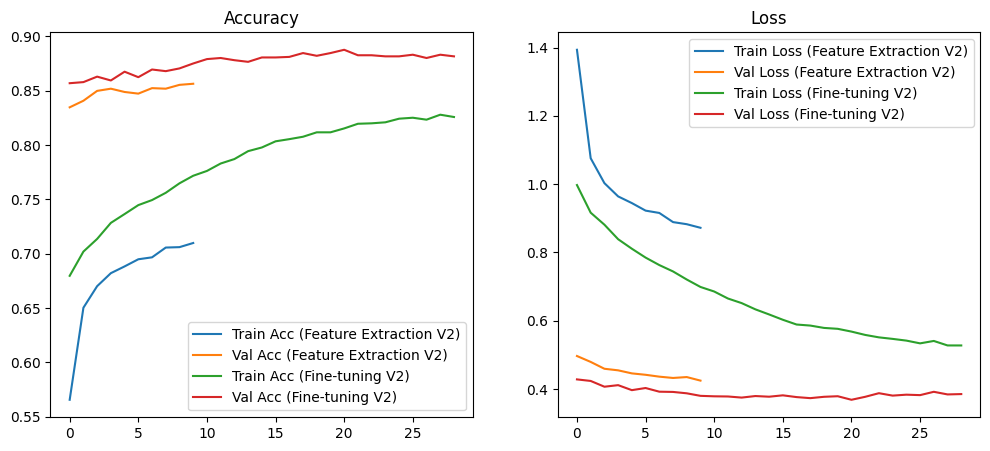

In [60]:
plot_history([fe_history_v2, fine_tune_history_v2],
             titles=["Feature Extraction V2", "Fine-tuning V2"])

### 3 - Vision Transformer (224 x 224)

#### 3.1 - Data Preprocessing

In [61]:
# Enable mixed precision for A100 (massive speed boost)
mixed_precision.set_global_policy("mixed_float16")

# Set the image size to (224, 224)
IMG_SIZE_224 = 224

# Define the preprocess function for vit_base_patch16_224
def preprocess_224(images, labels):
    # Resize all images to 224×224 (required by vit_base_patch16_224)
    images = tf.image.resize(images, (IMG_SIZE_224, IMG_SIZE_224))
    # Normalize to [-1, 1] for ViT
    images = tf.cast(images, tf.float32) / 255.0
    images = (images - 0.5) * 2.0
    return images, labels

In [62]:
# Apply preprocessing and Data set optimization
all_aug_ds_224 = (
    all_aug_ds_16
    .map(preprocess_224, num_parallel_calls=AUTOTUNE)
    .shuffle(1000)
    .prefetch(AUTOTUNE)
)

val_ds_224 = (
    val_ds
    .unbatch()
    .batch(16)
    .map(preprocess_224, num_parallel_calls=AUTOTUNE)
    .prefetch(AUTOTUNE)
)

test_ds_224 = (
    test_ds
    .unbatch()
    .batch(16)
    .map(preprocess_224, num_parallel_calls=AUTOTUNE)
    .prefetch(AUTOTUNE)
)

#### 3.2 - Build the base ViT-224 model

In [63]:
vit_backbone_224 = keras_hub.models.ViTBackbone.from_preset("vit_base_patch16_224_imagenet")
vit_backbone_224.trainable = False  # Freeze for initial training

inputs = tf.keras.Input(shape=(IMG_SIZE_224, IMG_SIZE_224, 3))
x = vit_backbone_224(inputs)
x = layers.Lambda(lambda t: t[:, 0, :])(x)  # extract CLS token
x = layers.Dense(256, activation="relu")(x)
x = layers.Dropout(0.4)(x)
outputs = layers.Dense(len(class_names), activation="softmax", dtype="float32")(x)

vit_model_224 = tf.keras.Model(inputs, outputs)

#### 3.3 - Train Classification Head

In [64]:
vit_model_224.compile(
    optimizer=tf.keras.optimizers.Adam(1e-4),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

# Create callbacks
early_stop = EarlyStopping(monitor="val_loss", patience=8, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-6)

print("\nPhase 1 (ViT-224): Training classifier head...")
vit_224_phase1_history = vit_model_224.fit(
    all_aug_ds_224,
    validation_data=val_ds_224,
    epochs=10,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)



Phase 1 (ViT-224): Training classifier head...
Epoch 1/10
2408/2409 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - accuracy: 0.6429 - loss: 1.1469

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


2409/2409 ━━━━━━━━━━━━━━━━━━━━ 120s 36ms/step - accuracy: 0.6430 - loss: 1.1466 - val_accuracy: 0.8790 - val_loss: 0.3645 - learning_rate: 1.0000e-04
Epoch 2/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 48s 16ms/step - accuracy: 0.8291 - loss: 0.5356 - val_accuracy: 0.8886 - val_loss: 0.3514 - learning_rate: 1.0000e-04
Epoch 3/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 48s 16ms/step - accuracy: 0.8565 - loss: 0.4484 - val_accuracy: 0.8936 - val_loss: 0.3322 - learning_rate: 1.0000e-04
Epoch 4/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 48s 16ms/step - accuracy: 0.8783 - loss: 0.3818 - val_accuracy: 0.8921 - val_loss: 0.3500 - learning_rate: 1.0000e-04
Epoch 5/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 48s 16ms/step - accuracy: 0.8887 - loss: 0.3436 - val_accuracy: 0.8926 - val_loss: 0.3466 - learning_rate: 1.0000e-04
Epoch 6/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 48s 16ms/step - accuracy: 0.9028 - loss: 0.3022 - val_accuracy: 0.8931 - val_loss: 0.3476 - learning_rate: 1.0000e-04
Epoch 7/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 47s 16ms

#### 3.4 - Fine Tuning Final Blocks

In [65]:
vit_backbone_224.trainable = True

# Freeze all layers first
for layer in vit_backbone_224.layers:
    layer.trainable = False

# Selectively unfreeze the last 3 transformer blocks
num_blocks = 12  # ViT-Base has 12 blocks
blocks_to_unfreeze = 3  # Unfreeze last 3 blocks

for layer in vit_backbone_224.layers:
    if "transformer" in layer.name:
        try:
            block_num = int(layer.name.split("_")[-1])
            if block_num >= (num_blocks - blocks_to_unfreeze):
                layer.trainable = True
                print(f"Unfreezing: {layer.name}")
        except:
            pass

# Also unfreeze the layer normalization at the end
for layer in vit_backbone_224.layers:
    if "layer_norm" in layer.name.lower() and layer == vit_backbone_224.layers[-1]:
        layer.trainable = True
        print(f"Unfreezing: {layer.name}")

vit_model_224.compile(
    optimizer=tf.keras.optimizers.Adam(1e-5),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

print(f"\n Phase 2 (ViT-224): Fine-tuning last {blocks_to_unfreeze} transformer blocks...")
print(f" Trainable params: {vit_model_224.count_params():,}")
vit_224_phase2_history = vit_model_224.fit(
    all_aug_ds_224,
    validation_data=val_ds_224,
    epochs=5,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)


 Phase 2 (ViT-224): Fine-tuning last 3 transformer blocks...
 Trainable params: 85,998,090
Epoch 1/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 91s 27ms/step - accuracy: 0.8733 - loss: 0.3899 - val_accuracy: 0.8896 - val_loss: 0.3474 - learning_rate: 1.0000e-05
Epoch 2/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 47s 16ms/step - accuracy: 0.8774 - loss: 0.3775 - val_accuracy: 0.8896 - val_loss: 0.3415 - learning_rate: 1.0000e-05
Epoch 3/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 48s 16ms/step - accuracy: 0.8829 - loss: 0.3645 - val_accuracy: 0.8942 - val_loss: 0.3323 - learning_rate: 1.0000e-05
Epoch 4/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 49s 16ms/step - accuracy: 0.8808 - loss: 0.3680 - val_accuracy: 0.8962 - val_loss: 0.3369 - learning_rate: 1.0000e-05
Epoch 5/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 49s 17ms/step - accuracy: 0.8857 - loss: 0.3542 - val_accuracy: 0.8957 - val_loss: 0.3405 - learning_rate: 1.0000e-05


#### 3.5 - Fine Tuning all model


In [66]:
print("\n Phase 3 (ViT-224): Gentle full model fine-tuning...")
for layer in vit_backbone_224.layers:
    layer.trainable = True

vit_model_224.compile(
    optimizer=tf.keras.optimizers.Adam(5e-6),  # Very low LR
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

vit_224_phase3_history = vit_model_224.fit(
    all_aug_ds_224,
    validation_data=val_ds_224,
    epochs=5,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)


 Phase 3 (ViT-224): Gentle full model fine-tuning...
Epoch 1/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 291s 91ms/step - accuracy: 0.8986 - loss: 0.3122 - val_accuracy: 0.9032 - val_loss: 0.3019 - learning_rate: 5.0000e-06
Epoch 2/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 122s 47ms/step - accuracy: 0.9614 - loss: 0.1344 - val_accuracy: 0.9068 - val_loss: 0.3178 - learning_rate: 5.0000e-06
Epoch 3/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 122s 47ms/step - accuracy: 0.9858 - loss: 0.0591 - val_accuracy: 0.9093 - val_loss: 0.3489 - learning_rate: 5.0000e-06
Epoch 4/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 122s 47ms/step - accuracy: 0.9952 - loss: 0.0254 - val_accuracy: 0.9057 - val_loss: 0.3912 - learning_rate: 5.0000e-06
Epoch 5/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 122s 47ms/step - accuracy: 0.9988 - loss: 0.0108 - val_accuracy: 0.9062 - val_loss: 0.4259 - learning_rate: 2.5000e-06


#### 3.6 - Plotting

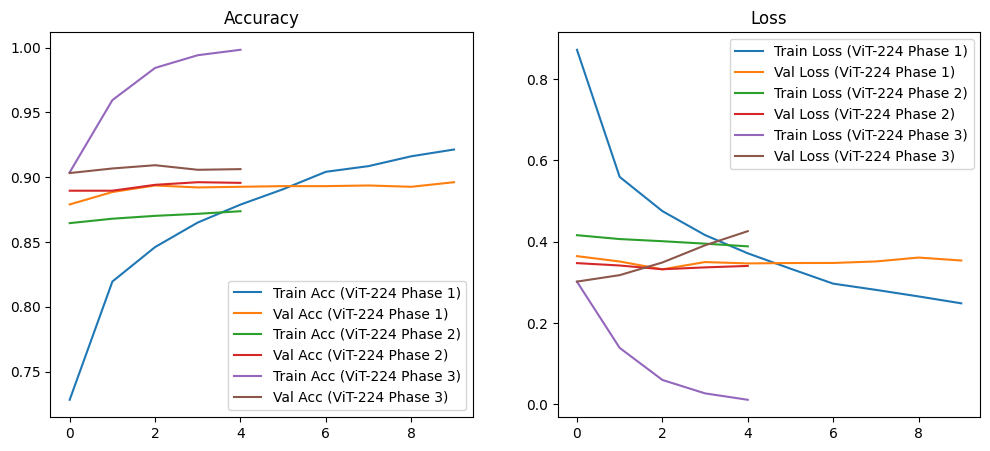

In [67]:
plot_history([vit_224_phase1_history, vit_224_phase2_history, vit_224_phase3_history],
             titles=["ViT-224 Phase 1", "ViT-224 Phase 2", "ViT-224 Phase 3"])

#### 3.7 - Evaluation

In [68]:
print("\n Evaluating ViT-224 model on test dataset...")
test_loss_224, test_acc_224 = vit_model_224.evaluate(test_ds_224)
print(f"\n ViT-224 Test Accuracy: {test_acc_224 * 100:.2f}%")
print(f"ViT-224 Test Loss: {test_loss_224:.4f}")


 Evaluating ViT-224 model on test dataset...
64/64 ━━━━━━━━━━━━━━━━━━━━ 15s 204ms/step - accuracy: 0.9064 - loss: 0.2896

 ViT-224 Test Accuracy: 91.16%
ViT-224 Test Loss: 0.2781


In [69]:
print("\n" + "="*50)
print("ViT-224 Training Complete!")
print("="*50)
print(f"Total parameters: {vit_model_224.count_params():,}")
print(f"Trainable parameters: {sum([tf.keras.backend.count_params(w) for w in vit_model_224.trainable_weights]):,}")
print("="*50)


ViT-224 Training Complete!
Total parameters: 85,998,090
Trainable parameters: 85,998,090


### 4 - Vision Transformer (384, 384)

#### 4.1 - Data Preprocessing

In [70]:
# Enable mixed precision for A100 (massive speed boost)
mixed_precision.set_global_policy("mixed_float16")

AUTOTUNE = tf.data.AUTOTUNE
IMG_SIZE_384 = 384

# Define the preprocess function for vit_base_patch16_384
def preprocess_384(images, labels):
    # Resize all images to 384×384 (required by vit_base_patch16_384)
    images = tf.image.resize(images, (IMG_SIZE_384, IMG_SIZE_384))
    # Normalize to [-1, 1] for ViT
    images = tf.cast(images, tf.float32) / 255.0
    images = (images - 0.5) * 2.0
    return images, labels

In [71]:
# Apply preprocessing + dataset optimization for 384
all_aug_ds_384 = (
    all_aug_ds_16
    .map(preprocess_384, num_parallel_calls=AUTOTUNE)
    .shuffle(1000)
    .prefetch(AUTOTUNE)
)

val_ds_384 = (
    val_ds
    .unbatch()
    .batch(16)
    .map(preprocess_384, num_parallel_calls=AUTOTUNE)
    .prefetch(AUTOTUNE)
)

test_ds_384 = (
    test_ds
    .unbatch()
    .batch(16)
    .map(preprocess_384, num_parallel_calls=AUTOTUNE)
    .prefetch(AUTOTUNE)
)

#### 4.2 - Build the base ViT-384 model

In [72]:
vit_backbone_384 = keras_hub.models.ViTBackbone.from_preset("vit_base_patch16_384_imagenet")
vit_backbone_384.trainable = False  # Freeze for initial training

inputs = tf.keras.Input(shape=(IMG_SIZE_384, IMG_SIZE_384, 3))
x = vit_backbone_384(inputs)
x = layers.Lambda(lambda t: t[:, 0, :])(x)  # extract CLS token
x = layers.Dense(256, activation="relu")(x)
x = layers.Dropout(0.4)(x)
outputs = layers.Dense(len(class_names), activation="softmax", dtype="float32")(x)

vit_model_384 = tf.keras.Model(inputs, outputs)

100%|██████████| 593/593 [00:00<00:00, 1.21MB/s]


100%|██████████| 329M/329M [00:21<00:00, 16.1MB/s]


#### 4.3 - Train Classification Head


In [73]:
vit_model_384.compile(
    optimizer=tf.keras.optimizers.Adam(1e-4),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

# Create callbacks
early_stop = EarlyStopping(monitor="val_loss", patience=8, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-6)

print("\nPhase 1 (ViT-384): Training classifier head...")
vit_384_phase1_history = vit_model_384.fit(
    all_aug_ds_384,
    validation_data=val_ds_384,
    epochs=10,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)


Phase 1 (ViT-384): Training classifier head...
Epoch 1/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 173s 57ms/step - accuracy: 0.6747 - loss: 1.0357 - val_accuracy: 0.9264 - val_loss: 0.2547 - learning_rate: 1.0000e-04
Epoch 2/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 106s 39ms/step - accuracy: 0.8587 - loss: 0.4424 - val_accuracy: 0.9330 - val_loss: 0.2401 - learning_rate: 1.0000e-04
Epoch 3/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 106s 39ms/step - accuracy: 0.8803 - loss: 0.3735 - val_accuracy: 0.9355 - val_loss: 0.2299 - learning_rate: 1.0000e-04
Epoch 4/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 105s 39ms/step - accuracy: 0.8946 - loss: 0.3250 - val_accuracy: 0.9355 - val_loss: 0.2341 - learning_rate: 1.0000e-04
Epoch 5/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 105s 39ms/step - accuracy: 0.9097 - loss: 0.2752 - val_accuracy: 0.9330 - val_loss: 0.2432 - learning_rate: 1.0000e-04
Epoch 6/10
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 105s 39ms/step - accuracy: 0.9145 - loss: 0.2611 - val_accuracy: 0.9309 - val_loss: 0.2538 - learning_rat

#### 4.4 - Fine-tuning Final Blocks

In [74]:
vit_backbone_384.trainable = True

# Freeze all layers first
for layer in vit_backbone_384.layers:
    layer.trainable = False

# Selectively unfreeze the last 3 transformer blocks
num_blocks = 12  # ViT-Base has 12 blocks
blocks_to_unfreeze = 3  # Unfreeze last 3 blocks

for layer in vit_backbone_384.layers:
    if "transformer" in layer.name:
        try:
            block_num = int(layer.name.split("_")[-1])
            if block_num >= (num_blocks - blocks_to_unfreeze):
                layer.trainable = True
                print(f"Unfreezing: {layer.name}")
        except:
            pass

# Also unfreeze the layer normalization at the end
for layer in vit_backbone_384.layers:
    if "layer_norm" in layer.name.lower() and layer == vit_backbone_384.layers[-1]:
        layer.trainable = True
        print(f"Unfreezing: {layer.name}")

vit_model_384.compile(
    optimizer=tf.keras.optimizers.Adam(1e-5),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

print(f"\nPhase 2 (ViT-384): Fine-tuning last {blocks_to_unfreeze} transformer blocks...")
print(f"Trainable params: {vit_model_384.count_params():,}")
vit_384_phase2_history = vit_model_384.fit(
    all_aug_ds_384,
    validation_data=val_ds_384,
    epochs=3,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)


Phase 2 (ViT-384): Fine-tuning last 3 transformer blocks...
Trainable params: 86,289,930
Epoch 1/3
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 148s 50ms/step - accuracy: 0.8978 - loss: 0.3106 - val_accuracy: 0.9375 - val_loss: 0.2232 - learning_rate: 1.0000e-05
Epoch 2/3
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 106s 40ms/step - accuracy: 0.9022 - loss: 0.3071 - val_accuracy: 0.9330 - val_loss: 0.2421 - learning_rate: 1.0000e-05
Epoch 3/3
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 105s 40ms/step - accuracy: 0.8986 - loss: 0.3143 - val_accuracy: 0.9345 - val_loss: 0.2377 - learning_rate: 1.0000e-05


#### 4.5 - Fine Tuning all model

In [75]:
print("\nPhase 3 (ViT-384): Gentle full model fine-tuning...")
for layer in vit_backbone_384.layers:
    layer.trainable = True

vit_model_384.compile(
    optimizer=tf.keras.optimizers.Adam(5e-6),  # Very low LR
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

vit_384_phase3_history = vit_model_384.fit(
    all_aug_ds_384,
    validation_data=val_ds_384,
    epochs=5,
    callbacks=[early_stop, reduce_lr],
    verbose=1
)



Phase 3 (ViT-384): Gentle full model fine-tuning...
Epoch 1/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 429s 147ms/step - accuracy: 0.9163 - loss: 0.2719 - val_accuracy: 0.9400 - val_loss: 0.2082 - learning_rate: 5.0000e-06
Epoch 2/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 255s 101ms/step - accuracy: 0.9652 - loss: 0.1206 - val_accuracy: 0.9415 - val_loss: 0.2146 - learning_rate: 5.0000e-06
Epoch 3/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 255s 102ms/step - accuracy: 0.9833 - loss: 0.0629 - val_accuracy: 0.9446 - val_loss: 0.2321 - learning_rate: 5.0000e-06
Epoch 4/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 256s 102ms/step - accuracy: 0.9926 - loss: 0.0300 - val_accuracy: 0.9435 - val_loss: 0.2637 - learning_rate: 5.0000e-06
Epoch 5/5
2409/2409 ━━━━━━━━━━━━━━━━━━━━ 256s 102ms/step - accuracy: 0.9974 - loss: 0.0143 - val_accuracy: 0.9446 - val_loss: 0.2724 - learning_rate: 2.5000e-06


#### 4.6 - Plotting

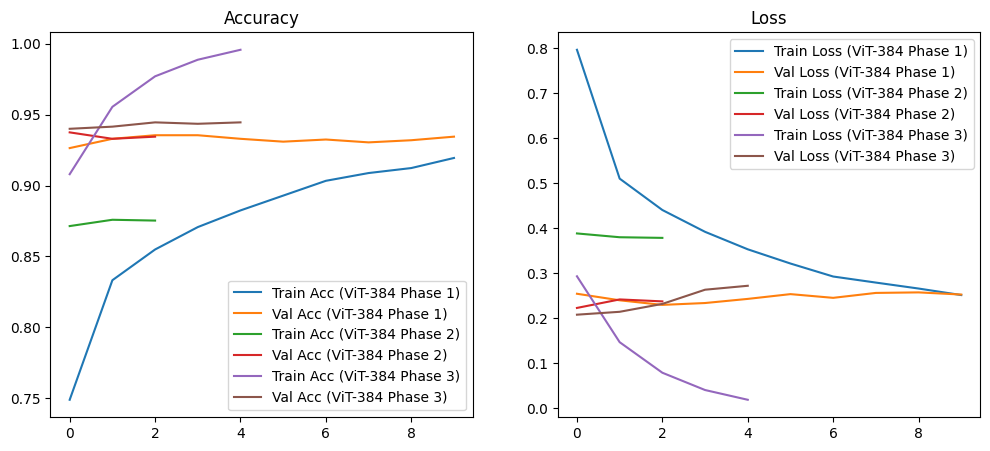

In [76]:
plot_history([vit_384_phase1_history, vit_384_phase2_history, vit_384_phase3_history],
             titles=["ViT-384 Phase 1", "ViT-384 Phase 2", "ViT-384 Phase 3"])

#### 4.7 - Evaluation

In [77]:
print("\nEvaluating ViT-384 model on test dataset...")
test_loss_384, test_acc_384 = vit_model_384.evaluate(test_ds_384)
print(f"\nViT-384 Test Accuracy: {test_acc_384 * 100:.2f}%")
print(f"ViT-384 Test Loss: {test_loss_384:.4f}")


Evaluating ViT-384 model on test dataset...
64/64 ━━━━━━━━━━━━━━━━━━━━ 14s 194ms/step - accuracy: 0.9555 - loss: 0.1623

ViT-384 Test Accuracy: 94.89%
ViT-384 Test Loss: 0.1691


In [78]:
print("\n" + "="*50)
print("ViT-384 Training Complete!")
print("="*50)
print(f"Model: vit_base_patch16_384_imagenet")
print(f"Input size: {IMG_SIZE_384}×{IMG_SIZE_384}")
print(f"Total parameters: {vit_model_384.count_params():,}")
print(f"Trainable parameters: {sum([tf.keras.backend.count_params(w) for w in vit_model_384.trainable_weights]):,}")
print("="*50)


ViT-384 Training Complete!
Model: vit_base_patch16_384_imagenet
Input size: 384×384
Total parameters: 86,289,930
Trainable parameters: 86,289,930


## D. Error Analysis

I will now analyse the results of the transfer learning model above to see what are the errors and then try to fix those problems and going back to train the model again.

In [79]:
# =====================================================
# Collect all misclassified images from test dataset
# =====================================================
def collect_misclassified_images(model, test_dataset, class_names):
    """
    Collects all misclassified images, their true labels, predicted labels,
    and prediction probabilities from the test dataset.

    Args:
        model: Trained model to evaluate
        test_dataset: TensorFlow dataset containing test images
        class_names: List of class names

    Returns:
        Dictionary containing misclassified data
    """
    misclassified_images = []
    misclassified_true_labels = []
    misclassified_pred_labels = []
    misclassified_probabilities = []

    print("Finding all misclassified images in the test set...")

    for images, labels in test_dataset:
        predictions = model.predict(images, verbose=0)
        predicted_indices = np.argmax(predictions, axis=1)
        true_indices = labels.numpy()

        # Find indices of errors in the current batch
        error_indices = np.where(predicted_indices != true_indices)[0]

        # Append the misclassified samples
        for idx in error_indices:
            misclassified_images.append(images[idx])
            misclassified_true_labels.append(true_indices[idx])
            misclassified_pred_labels.append(predicted_indices[idx])
            misclassified_probabilities.append(predictions[idx])

    print(f"Found {len(misclassified_images)} misclassified images out of {len(list(test_dataset.unbatch()))} total images.")

    return {
        'images': misclassified_images,
        'true_labels': misclassified_true_labels,
        'pred_labels': misclassified_pred_labels,
        'probabilities': misclassified_probabilities
    }

In [80]:
# =====================================================
# Save misclassified images to disk
# =====================================================
def save_misclassified_images(misclassified_data, class_names, output_dir='misclassified_images'):
    """
    Saves all misclassified images to a directory with descriptive filenames.

    Args:
        misclassified_data: Dictionary from collect_misclassified_images()
        class_names: List of class names
        output_dir: Directory path to save images
    """
    os.makedirs(output_dir, exist_ok=True)

    images = misclassified_data['images']
    true_labels = misclassified_data['true_labels']
    pred_labels = misclassified_data['pred_labels']

    print(f"Saving {len(images)} misclassified images to '{output_dir}' directory...")

    for i, image_tensor in enumerate(images):
        true_class = class_names[true_labels[i]]
        predicted_class = class_names[pred_labels[i]]

        filename = f"{i+1:03d}_True_{true_class}_Pred_{predicted_class}.png"
        filepath = os.path.join(output_dir, filename)

        tf.keras.utils.save_img(filepath, image_tensor.numpy())

    print(f"Done! Images saved to '{output_dir}/'")

In [101]:
# =====================================================
# Plot misclassified images with confidence scores
# =====================================================
def plot_misclassified_with_confidences(misclassified_data, class_names, page_number=0, images_per_page=5):
    """
    Plots misclassified images with their confidence scores for all classes.
    Each image is shown alongside a bar plot of class probabilities.

    Args:
        misclassified_data: Dictionary from collect_misclassified_images()
        class_names: List of class names
        page_number: Page to display (0-indexed)
        images_per_page: Number of images per page
    """
    images = misclassified_data['images']
    true_labels = misclassified_data['true_labels']
    pred_labels = misclassified_data['pred_labels']
    probabilities = misclassified_data['probabilities']

    if not images:
        print("No misclassified images to display.")
        return

    # Calculate page range
    start_idx = page_number * images_per_page
    end_idx = min(start_idx + images_per_page, len(images))

    if start_idx >= len(images):
        max_page = (len(images) - 1) // images_per_page
        print(f"Page {page_number} is out of range. Max page is {max_page}.")
        return

    # Select current page data
    page_images = images[start_idx:end_idx]
    page_true = true_labels[start_idx:end_idx]
    page_pred = pred_labels[start_idx:end_idx]
    page_probs = probabilities[start_idx:end_idx]

    # Create figure
    fig = plt.figure(figsize=(16, 4 * len(page_images)))

    for i in range(len(page_images)):
        true_idx = page_true[i]
        pred_idx = page_pred[i]
        probs = page_probs[i]

        true_class = class_names[true_idx]
        pred_class = class_names[pred_idx]
        confidence = probs[pred_idx]

        # Left subplot: Image
        plt.subplot(len(page_images), 2, 2 * i + 1)
        img = page_images[i]
        if tf.reduce_max(img) <= 1.0:
            # probably [0, 1] or [-1, 1] range
            if tf.reduce_min(img) < 0:
                img = (img + 1.0) / 2.0  # convert [-1,1] → [0,1]
            img = tf.clip_by_value(img * 255.0, 0, 255)
        else:
            # already [0,255]
            img = tf.clip_by_value(img, 0, 255)

        img = tf.cast(img, tf.uint8).numpy()
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"True: {true_class}\nPredicted: {pred_class} (conf: {confidence:.3f})",
                 color="red", fontsize=11, fontweight='bold')

        # Right subplot: Confidence bar chart
        plt.subplot(len(page_images), 2, 2 * i + 2)
        colors = ['lightcoral' if j == pred_idx else 'lightgreen' if j == true_idx else 'lightblue'
                  for j in range(len(class_names))]

        bars = plt.barh(range(len(class_names)), probs, color=colors)
        plt.yticks(range(len(class_names)), class_names, fontsize=9)
        plt.xlabel("Confidence Score", fontsize=10)
        plt.xlim(0, 1)
        plt.grid(axis='x', alpha=0.3)

        # Add legend
        from matplotlib.patches import Patch
        legend_elements = [
            Patch(facecolor='lightgreen', label='True Class'),
            Patch(facecolor='lightcoral', label='Predicted Class')
        ]
        plt.legend(handles=legend_elements, loc='lower right', fontsize=8)
        plt.title(f"Class Probabilities (Image {start_idx + i + 1})", fontsize=10)

    plt.suptitle(f"Misclassified Images - Page {page_number + 1}/{(len(images)-1)//images_per_page + 1}",
                 fontsize=14, fontweight='bold', y=0.995)
    plt.tight_layout()
    plt.show()


In [82]:

# =====================================================
# Comprehensive model evaluation metrics
# =====================================================
def evaluate_model_comprehensive(model, test_dataset, class_names):
    """
    Performs comprehensive evaluation including accuracy metrics,
    classification report, and confusion matrices.

    Args:
        model: Trained model to evaluate
        test_dataset: TensorFlow dataset containing test images
        class_names: List of class names

    Returns:
        Dictionary containing all evaluation metrics
    """
    all_true = []
    all_pred = []
    all_probs = []

    print("Collecting predictions for the entire test dataset...")

    for images, labels in test_dataset:
        predictions = model.predict(images, verbose=0)
        predicted_indices = np.argmax(predictions, axis=1)
        true_indices = labels.numpy()

        all_pred.extend(predicted_indices)
        all_true.extend(true_indices)
        all_probs.extend(predictions)

    all_true = np.array(all_true)
    all_pred = np.array(all_pred)
    all_probs = np.array(all_probs)

    # Calculate Top-1 Accuracy
    top1_accuracy = np.mean(all_true == all_pred)

    # Calculate Average Accuracy per Class (Balanced Accuracy)
    per_class_accuracy = []
    for class_idx in range(len(class_names)):
        class_mask = all_true == class_idx
        if np.sum(class_mask) > 0:
            class_acc = np.mean(all_pred[class_mask] == all_true[class_mask])
            per_class_accuracy.append(class_acc)

    avg_per_class_accuracy = np.mean(per_class_accuracy)

    # Print metrics
    print("\n" + "="*60)
    print("MODEL EVALUATION METRICS")
    print("="*60)
    print(f"Top-1 Accuracy: {top1_accuracy * 100:.2f}%")
    print(f"  (How often the top predicted class matches the true label)")
    print(f"\nAverage Accuracy per Class: {avg_per_class_accuracy * 100:.2f}%")
    print(f"  (Mean of individual class accuracies - handles class imbalance)")
    print("="*60)

    # Per-class accuracy breakdown
    print("\nPER-CLASS ACCURACY:")
    print("-" * 60)
    for i, class_name in enumerate(class_names):
        if i < len(per_class_accuracy):
            print(f"{class_name:20s}: {per_class_accuracy[i] * 100:6.2f}%")
    print("-" * 60)

    # Classification Report
    print("\nCLASSIFICATION REPORT:")
    print("-" * 60)
    report = classification_report(all_true, all_pred, target_names=class_names, digits=3)
    print(report)

    # Confusion Matrix
    cm = confusion_matrix(all_true, all_pred)
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names,
                cbar_kws={'label': 'Count'})
    plt.title("Confusion Matrix (Test Set)", fontsize=16, fontweight='bold', pad=20)
    plt.xlabel("Predicted Labels", fontsize=12)
    plt.ylabel("True Labels", fontsize=12)
    plt.tight_layout()
    plt.show()

    # Normalized Confusion Matrix
    cm_normalized = confusion_matrix(all_true, all_pred, normalize='true')
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm_normalized, annot=True, fmt=".2f", cmap="Greens",
                xticklabels=class_names, yticklabels=class_names,
                cbar_kws={'label': 'Proportion'})
    plt.title("Normalized Confusion Matrix (Test Set)", fontsize=16, fontweight='bold', pad=20)
    plt.xlabel("Predicted Labels", fontsize=12)
    plt.ylabel("True Labels", fontsize=12)
    plt.tight_layout()
    plt.show()

    return {
        'top1_accuracy': top1_accuracy,
        'avg_per_class_accuracy': avg_per_class_accuracy,
        'per_class_accuracy': per_class_accuracy,
        'confusion_matrix': cm,
        'normalized_confusion_matrix': cm_normalized,
        'all_true': all_true,
        'all_pred': all_pred,
        'all_probs': all_probs
    }

In [83]:
models_config = {
    'ViT-384': {
        'model': vit_model_384,
        'test_ds': test_ds_384,
        'description': 'Vision Transformer with 384x384 input'
    },
    'ViT-224': {
        'model': vit_model_224,
        'test_ds': test_ds_224,
        'description': 'Vision Transformer with 224x224 input'
    },
    'EfficientNetV2-B0 (v2)': {
        'model': model,
        'test_ds': test_ds,
        'description': 'EfficientNetV2B0 with all_aug_ds_32'
    },
    'EfficientNetV2-B0 (v1)': {
        'model': model_v1,
        'test_ds': test_ds,
        'description': 'EfficientNetV2B0 with data augmentation layer'
    },
    'Baseline Model': {
        'model': baseline_model,
        'test_ds': test_ds,
        'description': 'Baseline model'
    }
}


EVALUATING ALL MODELS

MODEL: ViT-384
Description: Vision Transformer with 384x384 input

MODEL EVALUATION METRICS
Top-1 Accuracy: 94.40%
  (How often the top predicted class matches the true label)

Average Accuracy per Class: 94.45%
  (Mean of individual class accuracies - handles class imbalance)

PER-CLASS ACCURACY:
------------------------------------------------------------
Amphibia            :  96.88%
Animalia            :  93.94%
Arachnida           :  93.00%
Aves                :  96.59%
Fungi               :  96.26%
Insecta             :  95.08%
Mammalia            :  91.82%
Mollusca            :  90.27%
Plantae             :  92.68%
Reptilia            :  98.02%
------------------------------------------------------------

CLASSIFICATION REPORT:
------------------------------------------------------------
              precision    recall  f1-score   support

    Amphibia      0.930     0.969     0.949        96
    Animalia      0.921     0.939     0.930        99
   Arac

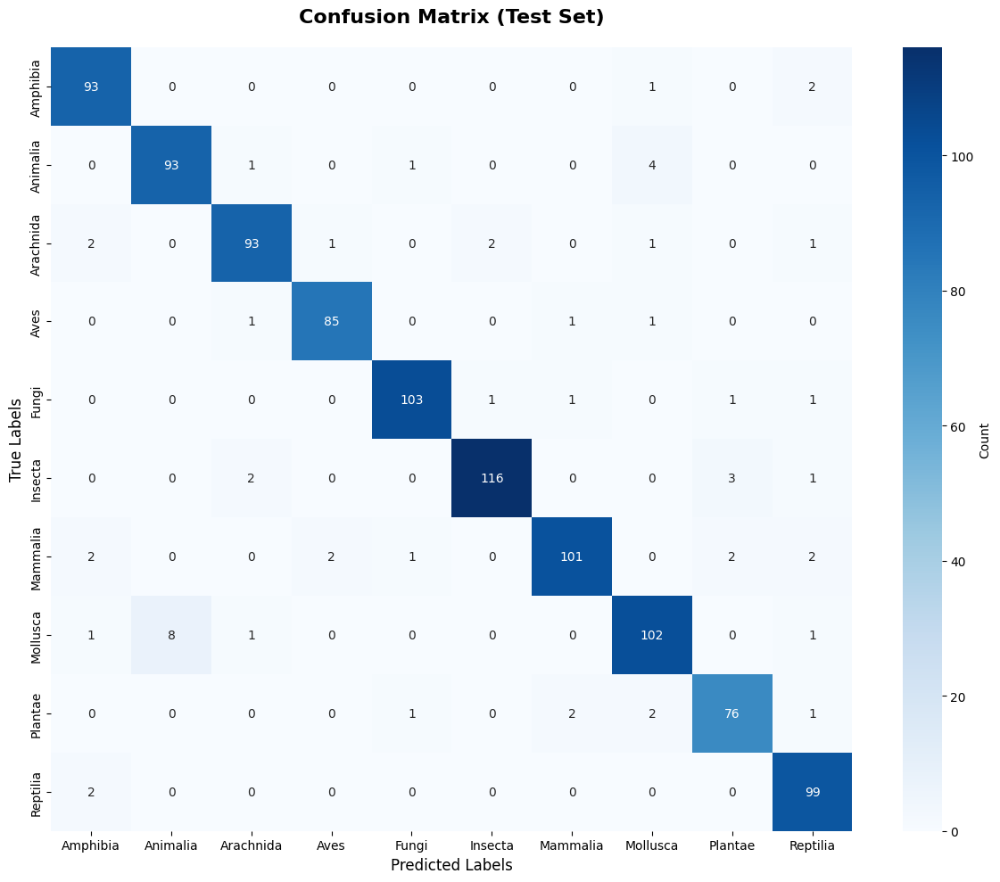

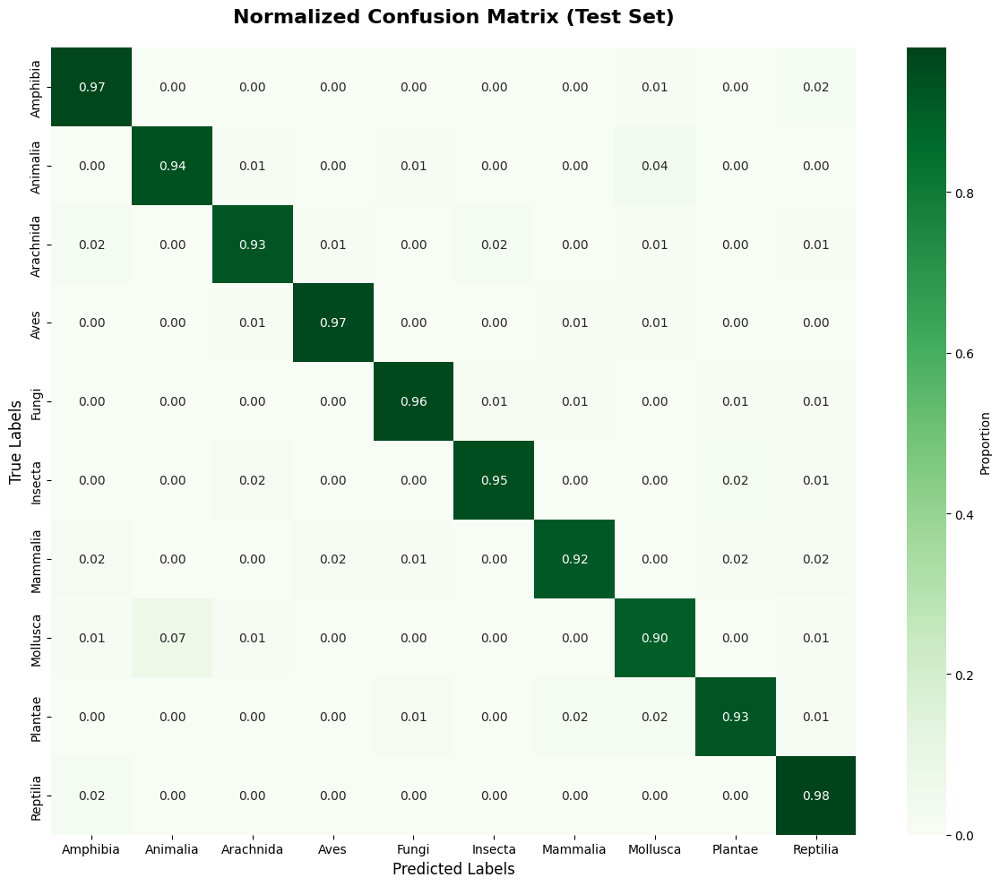


MODEL: ViT-224
Description: Vision Transformer with 224x224 input

MODEL EVALUATION METRICS
Top-1 Accuracy: 90.77%
  (How often the top predicted class matches the true label)

Average Accuracy per Class: 90.75%
  (Mean of individual class accuracies - handles class imbalance)

PER-CLASS ACCURACY:
------------------------------------------------------------
Amphibia            :  89.25%
Animalia            :  86.00%
Arachnida           :  87.63%
Aves                :  95.74%
Fungi               :  92.66%
Insecta             :  89.57%
Mammalia            :  97.17%
Mollusca            :  89.43%
Plantae             :  88.76%
Reptilia            :  91.30%
------------------------------------------------------------

CLASSIFICATION REPORT:
------------------------------------------------------------
              precision    recall  f1-score   support

    Amphibia      0.865     0.892     0.878        93
    Animalia      0.869     0.860     0.864       100
   Arachnida      0.955     0.

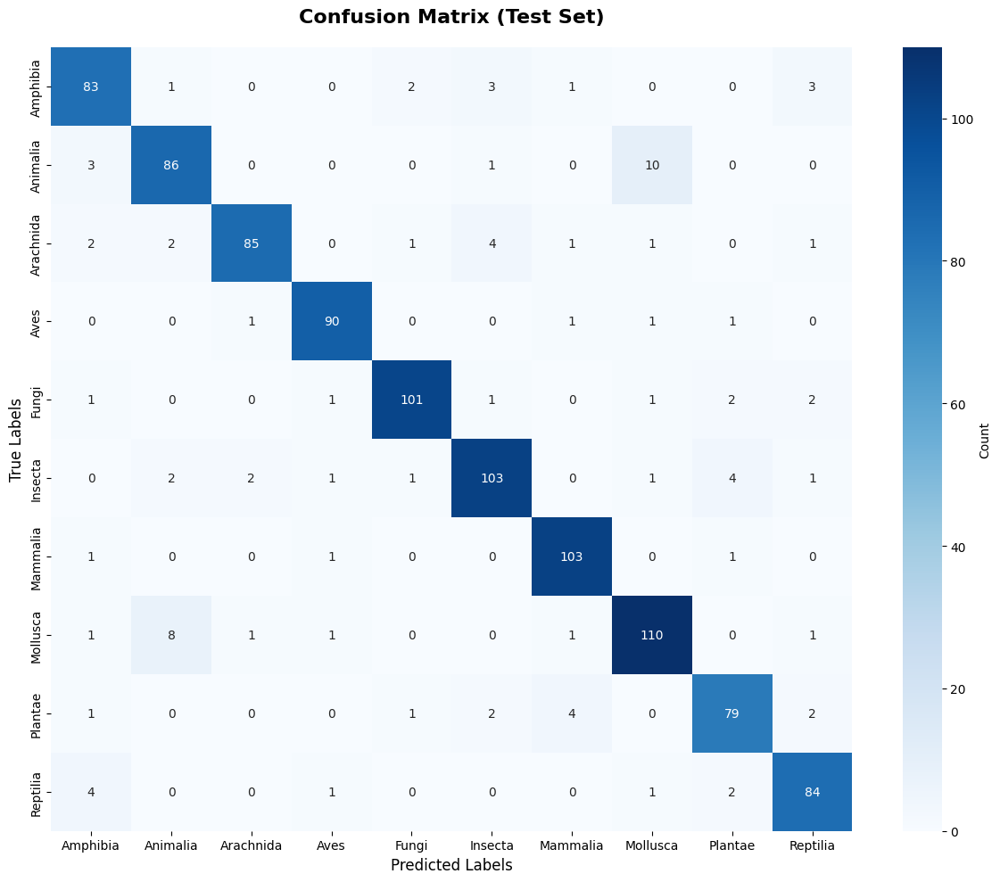

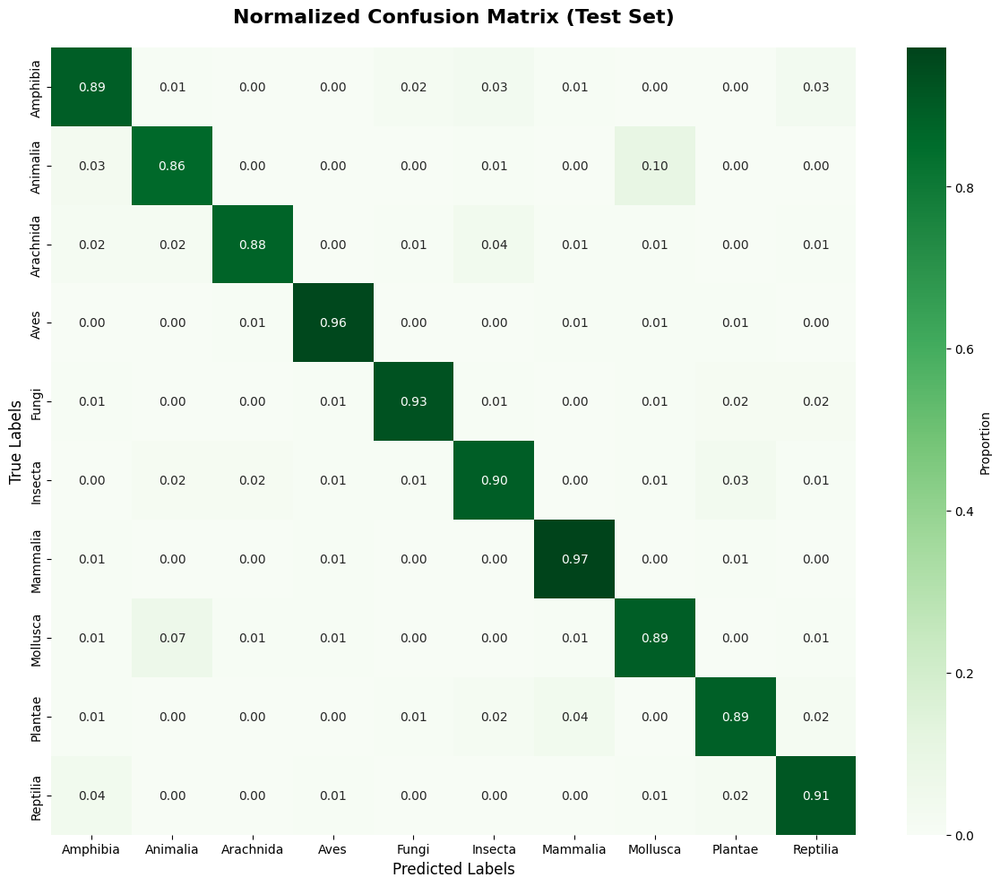


MODEL: EfficientNetV2-B0 (v2)
Description: EfficientNetV2B0 with all_aug_ds_32

MODEL EVALUATION METRICS
Top-1 Accuracy: 89.00%
  (How often the top predicted class matches the true label)

Average Accuracy per Class: 89.12%
  (Mean of individual class accuracies - handles class imbalance)

PER-CLASS ACCURACY:
------------------------------------------------------------
Amphibia            :  91.00%
Animalia            :  86.32%
Arachnida           :  90.53%
Aves                :  95.35%
Fungi               :  93.33%
Insecta             :  86.55%
Mammalia            :  89.81%
Mollusca            :  86.32%
Plantae             :  85.87%
Reptilia            :  86.14%
------------------------------------------------------------

CLASSIFICATION REPORT:
------------------------------------------------------------
              precision    recall  f1-score   support

    Amphibia      0.820     0.910     0.863       100
    Animalia      0.845     0.863     0.854        95
   Arachnida     

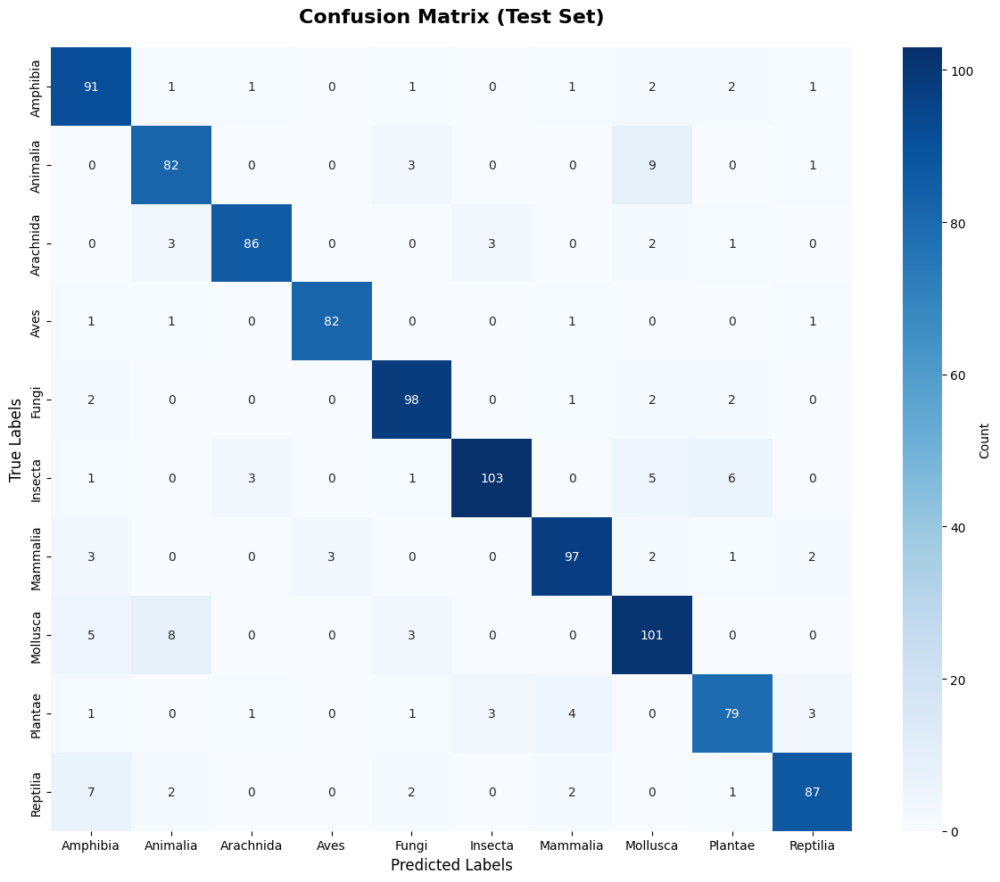

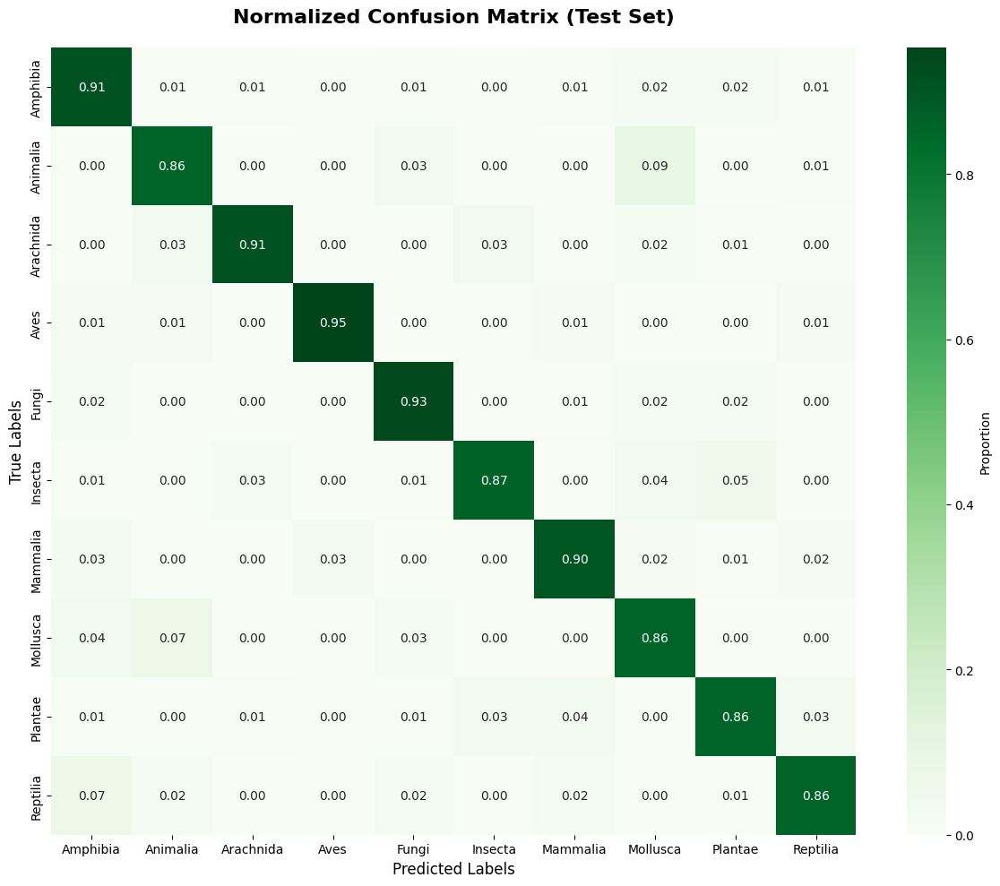


MODEL: EfficientNetV2-B0 (v1)
Description: EfficientNetV2B0 with data augmentation layer

MODEL EVALUATION METRICS
Top-1 Accuracy: 86.35%
  (How often the top predicted class matches the true label)

Average Accuracy per Class: 86.42%
  (Mean of individual class accuracies - handles class imbalance)

PER-CLASS ACCURACY:
------------------------------------------------------------
Amphibia            :  92.47%
Animalia            :  81.63%
Arachnida           :  89.69%
Aves                :  93.62%
Fungi               :  87.50%
Insecta             :  85.84%
Mammalia            :  92.73%
Mollusca            :  79.13%
Plantae             :  76.60%
Reptilia            :  85.00%
------------------------------------------------------------

CLASSIFICATION REPORT:
------------------------------------------------------------
              precision    recall  f1-score   support

    Amphibia      0.748     0.925     0.827        93
    Animalia      0.800     0.816     0.808        98
   Arac

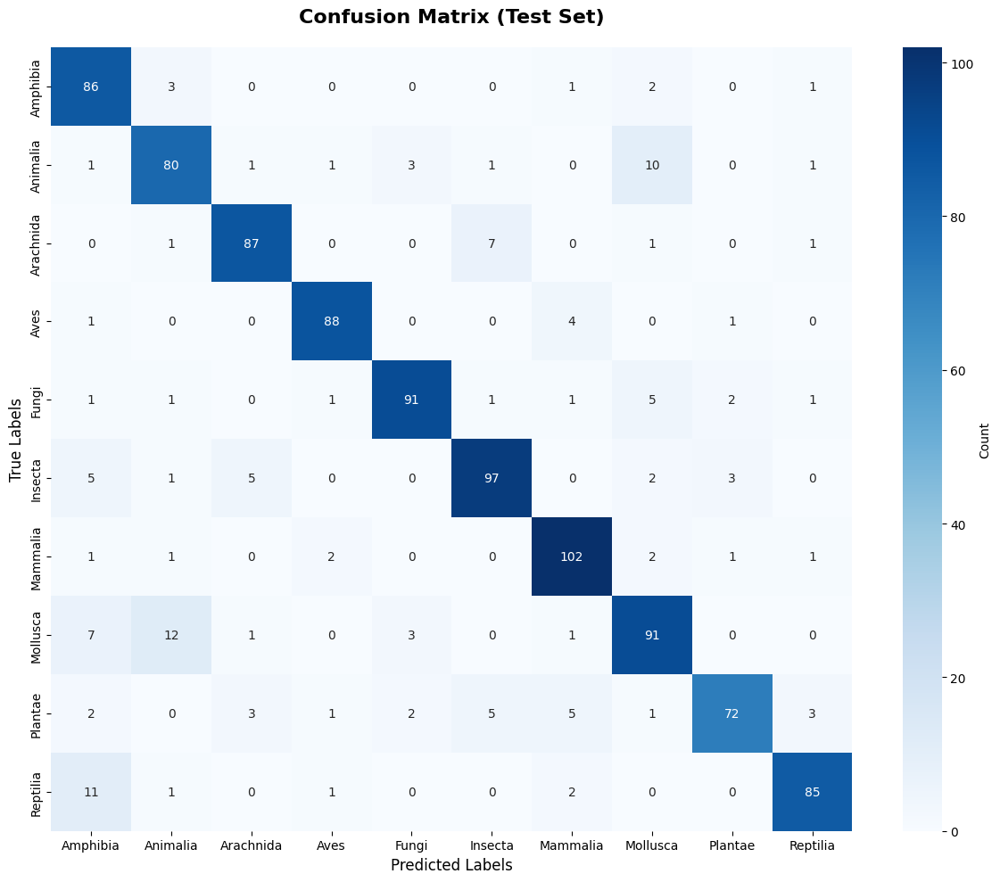

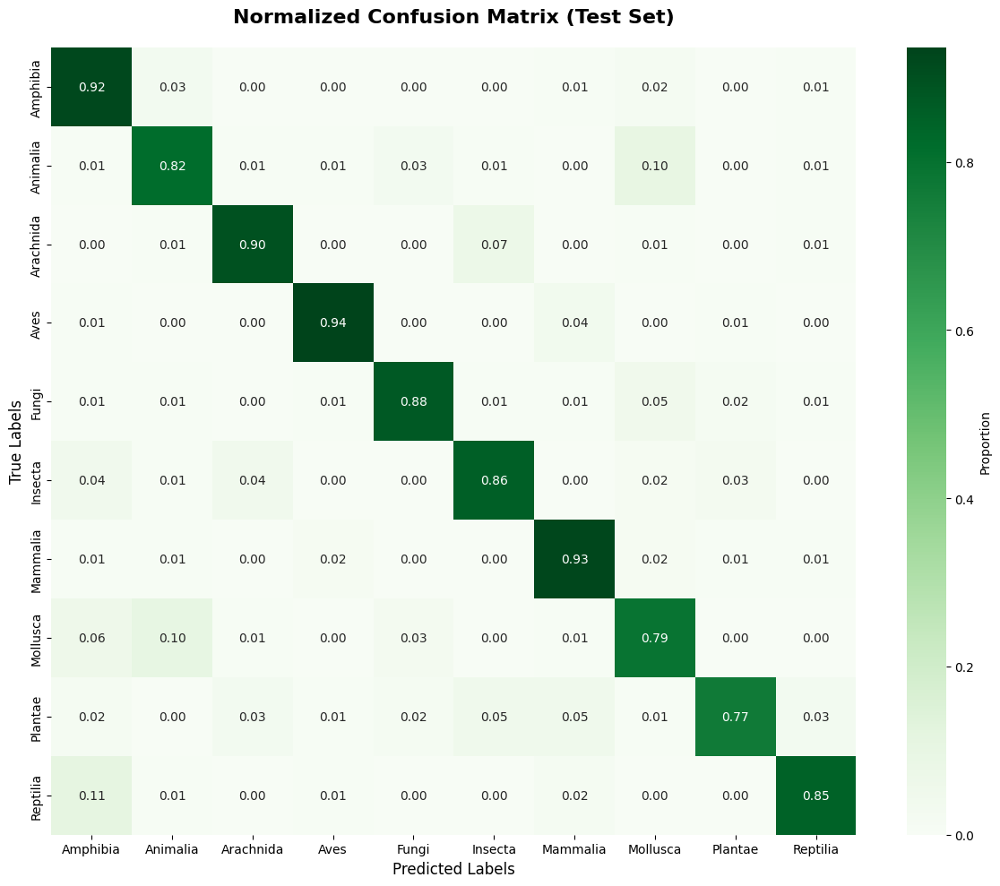


MODEL: Baseline Model
Description: Baseline model

MODEL EVALUATION METRICS
Top-1 Accuracy: 29.67%
  (How often the top predicted class matches the true label)

Average Accuracy per Class: 30.26%
  (Mean of individual class accuracies - handles class imbalance)

PER-CLASS ACCURACY:
------------------------------------------------------------
Amphibia            :  19.79%
Animalia            :  45.45%
Arachnida           :  21.65%
Aves                :  48.94%
Fungi               :  18.35%
Insecta             :  19.13%
Mammalia            :  32.41%
Mollusca            :  26.67%
Plantae             :  47.06%
Reptilia            :  23.16%
------------------------------------------------------------

CLASSIFICATION REPORT:
------------------------------------------------------------
              precision    recall  f1-score   support

    Amphibia      0.306     0.198     0.241        96
    Animalia      0.247     0.455     0.320        99
   Arachnida      0.256     0.216     0.235   

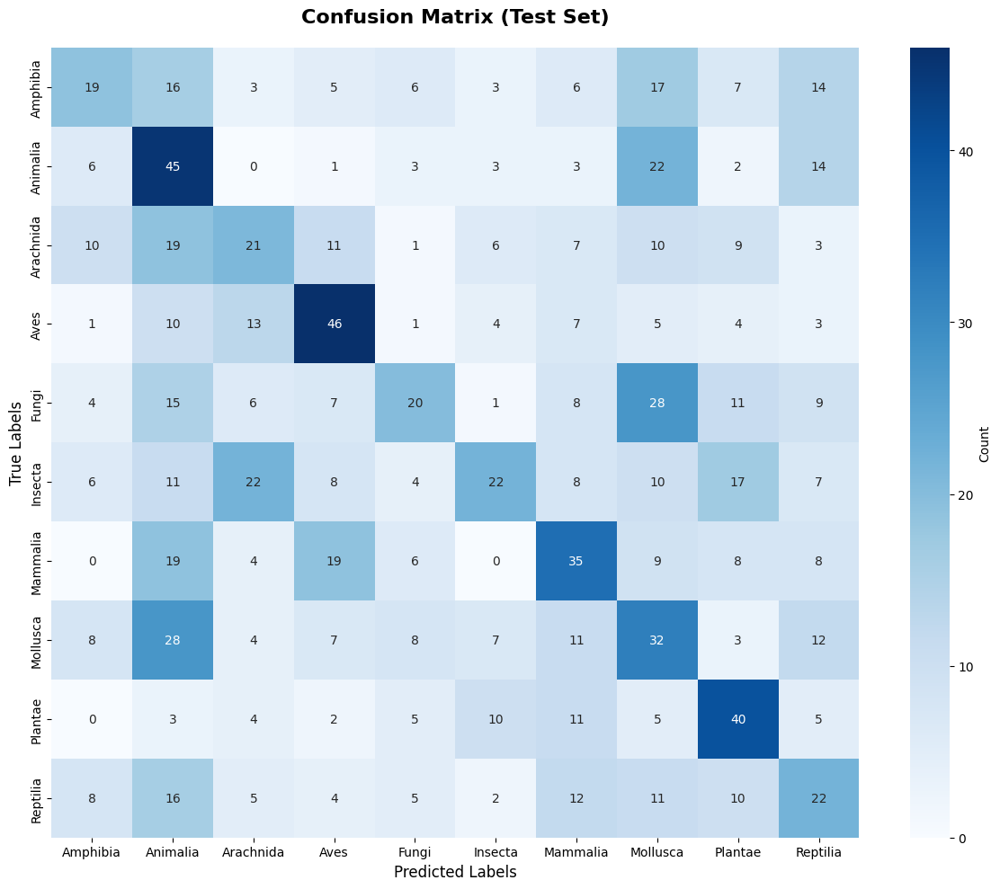

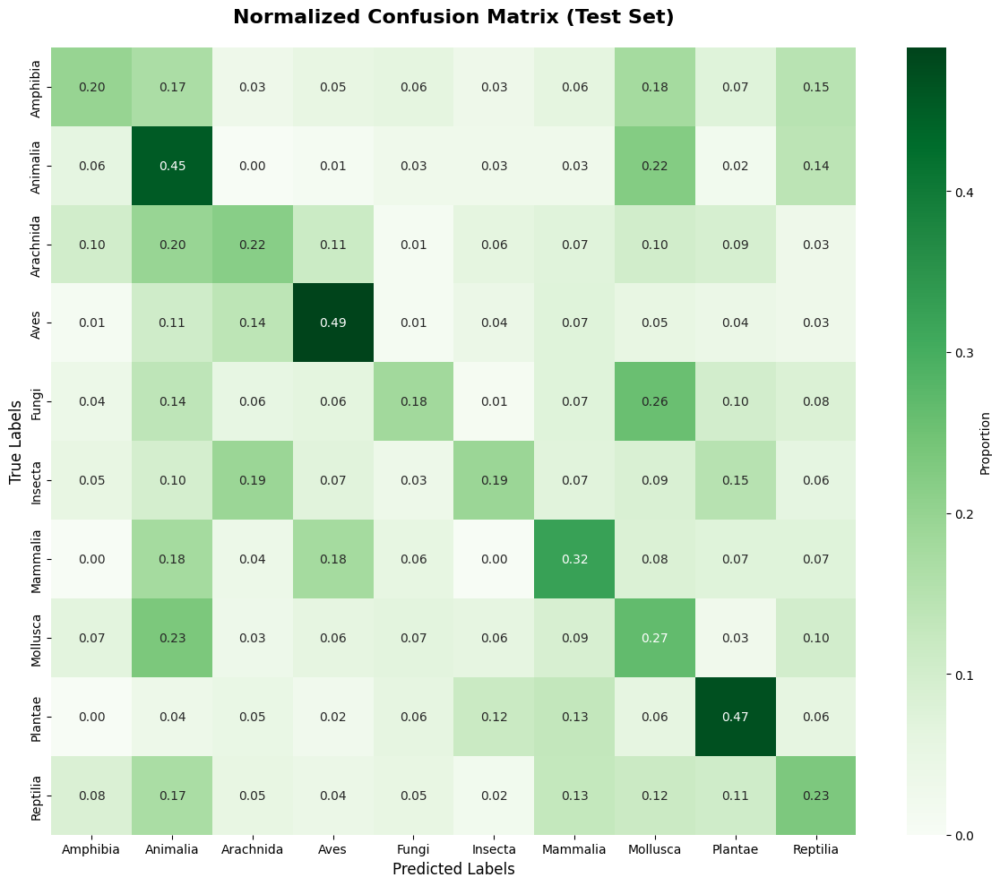

In [84]:
# =====================================================
# Evaluate all models and store results
# =====================================================
all_results = {}

print("\n" + "="*80)
print("EVALUATING ALL MODELS")
print("="*80)

for model_name, config in models_config.items():
    print(f"\n{'='*80}")
    print(f"MODEL: {model_name}")
    print(f"Description: {config['description']}")
    print(f"{'='*80}")

    # Evaluate model
    results = evaluate_model_comprehensive(
        model=config['model'],
        test_dataset=config['test_ds'],
        class_names=class_names
    )

    # Store results
    all_results[model_name] = results

In [85]:
# =====================================================
# Collect misclassified images for all models
# =====================================================
all_misclassified = {}

print("\n" + "="*80)
print("COLLECTING MISCLASSIFIED IMAGES FOR ALL MODELS")
print("="*80)

for model_name, config in models_config.items():
    print(f"\nProcessing {model_name}...")

    misclassified_data = collect_misclassified_images(
        model=config['model'],
        test_dataset=config['test_ds'],
        class_names=class_names
    )

    all_misclassified[model_name] = misclassified_data

    # Save misclassified images to separate directories
    output_dir = f'misclassified_{model_name.replace(" ", "_").replace("-", "_")}'
    save_misclassified_images(misclassified_data, class_names, output_dir=output_dir)


COLLECTING MISCLASSIFIED IMAGES FOR ALL MODELS

Processing ViT-384...
Finding all misclassified images in the test set...
Found 53 misclassified images out of 1018 total images.
Saving 53 misclassified images to 'misclassified_ViT_384' directory...
Done! Images saved to 'misclassified_ViT_384/'

Processing ViT-224...
Finding all misclassified images in the test set...
Found 83 misclassified images out of 1018 total images.
Saving 83 misclassified images to 'misclassified_ViT_224' directory...
Done! Images saved to 'misclassified_ViT_224/'

Processing EfficientNetV2-B0 (v2)...
Finding all misclassified images in the test set...
Found 111 misclassified images out of 1018 total images.
Saving 111 misclassified images to 'misclassified_EfficientNetV2_B0_(v2)' directory...
Done! Images saved to 'misclassified_EfficientNetV2_B0_(v2)/'

Processing EfficientNetV2-B0 (v1)...
Finding all misclassified images in the test set...
Found 134 misclassified images out of 1018 total images.
Saving 134 

In [86]:
# =====================================================
# Compare all models side by side
# =====================================================
def compare_models_summary(all_results, class_names):
    """
    Creates a summary comparison table of all models.

    Args:
        all_results: Dictionary of evaluation results for each model
        class_names: List of class names
    """
    print("\n" + "="*100)
    print("MODEL COMPARISON SUMMARY")
    print("="*100)

    # Header
    print(f"\n{'Model':<30} {'Top-1 Acc':<12} {'Avg Class Acc':<15} {'Misclassified':<15}")
    print("-" * 100)

    # Data rows
    for model_name, results in all_results.items():
        top1_acc = results['top1_accuracy'] * 100
        avg_class_acc = results['avg_per_class_accuracy'] * 100
        total_samples = len(results['all_true'])
        misclassified = total_samples - np.sum(results['all_true'] == results['all_pred'])

        print(f"{model_name:<30} {top1_acc:>10.2f}% {avg_class_acc:>13.2f}% {misclassified:>10}/{total_samples:<5}")

    print("-" * 100)

    # Per-class comparison
    print("\n" + "="*100)
    print("PER-CLASS ACCURACY COMPARISON")
    print("="*100)

    # Create comparison table
    print(f"\n{'Class':<20}", end="")
    for model_name in all_results.keys():
        print(f"{model_name:<18}", end="")
    print()
    print("-" * (20 + 18 * len(all_results)))

    for class_idx, class_name in enumerate(class_names):
        print(f"{class_name:<20}", end="")
        for model_name, results in all_results.items():
            per_class_acc = results['per_class_accuracy']
            if class_idx < len(per_class_acc):
                print(f"{per_class_acc[class_idx]*100:>15.2f}% ", end="")
            else:
                print(f"{'N/A':>15}  ", end="")
        print()

    print("-" * (20 + 18 * len(all_results)))

In [87]:
# =====================================================
# Visualize model comparison
# =====================================================
def plot_model_comparison(all_results):
    """
    Creates visualization comparing all models' performance.

    Args:
        all_results: Dictionary of evaluation results for each model
    """
    model_names = list(all_results.keys())
    top1_accs = [all_results[name]['top1_accuracy'] * 100 for name in model_names]
    avg_class_accs = [all_results[name]['avg_per_class_accuracy'] * 100 for name in model_names]

    # Bar chart comparison
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

    # Top-1 Accuracy comparison
    bars1 = ax1.bar(range(len(model_names)), top1_accs, color='steelblue', alpha=0.8)
    ax1.set_xlabel('Model', fontsize=12, fontweight='bold')
    ax1.set_ylabel('Top-1 Accuracy (%)', fontsize=12, fontweight='bold')
    ax1.set_title('Top-1 Accuracy Comparison', fontsize=14, fontweight='bold')
    ax1.set_xticks(range(len(model_names)))
    ax1.set_xticklabels(model_names, rotation=45, ha='right')
    ax1.set_ylim(0, 100)
    ax1.grid(axis='y', alpha=0.3)

    # Add value labels on bars
    for bar in bars1:
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.2f}%', ha='center', va='bottom', fontsize=10)

    # Average Class Accuracy comparison
    bars2 = ax2.bar(range(len(model_names)), avg_class_accs, color='coral', alpha=0.8)
    ax2.set_xlabel('Model', fontsize=12, fontweight='bold')
    ax2.set_ylabel('Average Class Accuracy (%)', fontsize=12, fontweight='bold')
    ax2.set_title('Average Per-Class Accuracy Comparison', fontsize=14, fontweight='bold')
    ax2.set_xticks(range(len(model_names)))
    ax2.set_xticklabels(model_names, rotation=45, ha='right')
    ax2.set_ylim(0, 100)
    ax2.grid(axis='y', alpha=0.3)

    # Add value labels on bars
    for bar in bars2:
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.2f}%', ha='center', va='bottom', fontsize=10)

    plt.tight_layout()
    plt.show()

    # Per-class accuracy heatmap
    per_class_data = []
    for model_name in model_names:
        per_class_data.append(all_results[model_name]['per_class_accuracy'])

    per_class_data = np.array(per_class_data) * 100

    plt.figure(figsize=(14, 8))
    sns.heatmap(per_class_data, annot=True, fmt='.1f', cmap='RdYlGn',
                xticklabels=class_names, yticklabels=model_names,
                cbar_kws={'label': 'Accuracy (%)'}, vmin=0, vmax=100)
    plt.title('Per-Class Accuracy Heatmap - All Models', fontsize=16, fontweight='bold', pad=20)
    plt.xlabel('Class', fontsize=12, fontweight='bold')
    plt.ylabel('Model', fontsize=12, fontweight='bold')
    plt.tight_layout()
    plt.show()

In [99]:
# =====================================================
# View misclassified images for specific model
# =====================================================
def view_model_misclassifications(model_name, all_misclassified, class_names, page_number=0, images_per_page=5):
    """
    View misclassified images for a specific model.

    Args:
        model_name: Name of the model to view
        all_misclassified: Dictionary of misclassified data for all models
        class_names: List of class names
        page_number: Page number to display
        images_per_page: Number of images per page
    """
    if model_name not in all_misclassified:
        print(f"Model '{model_name}' not found. Available models:")
        for name in all_misclassified.keys():
            print(f"  - {name}")
        return

    print(f"\nViewing misclassifications for: {model_name}")
    plot_misclassified_with_confidences(
        all_misclassified[model_name],
        class_names,
        page_number=page_number,
        images_per_page=images_per_page
    )


MODEL COMPARISON SUMMARY

Model                          Top-1 Acc    Avg Class Acc   Misclassified  
----------------------------------------------------------------------------------------------------
ViT-384                             94.40%         94.45%         57/1018 
ViT-224                             90.77%         90.75%         94/1018 
EfficientNetV2-B0 (v2)              89.00%         89.12%        112/1018 
EfficientNetV2-B0 (v1)              86.35%         86.42%        139/1018 
Baseline Model                      29.67%         30.26%        716/1018 
----------------------------------------------------------------------------------------------------

PER-CLASS ACCURACY COMPARISON

Class               ViT-384           ViT-224           EfficientNetV2-B0 (v2)EfficientNetV2-B0 (v1)Baseline Model    
--------------------------------------------------------------------------------------------------------------
Amphibia                      96.88%           89.25%     

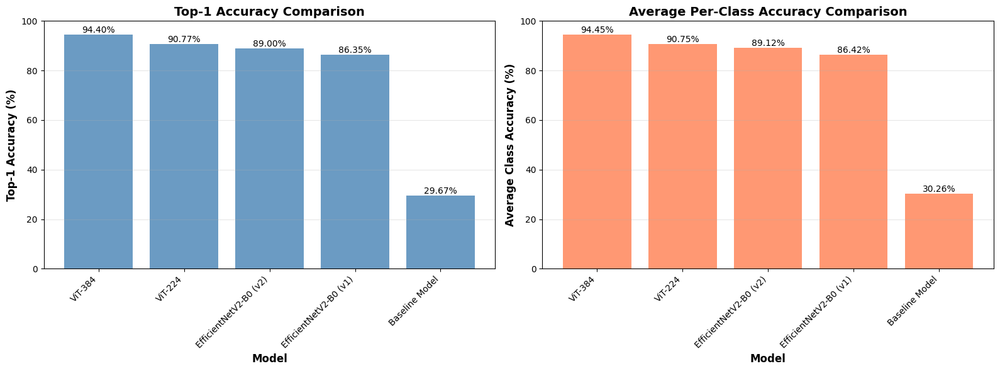

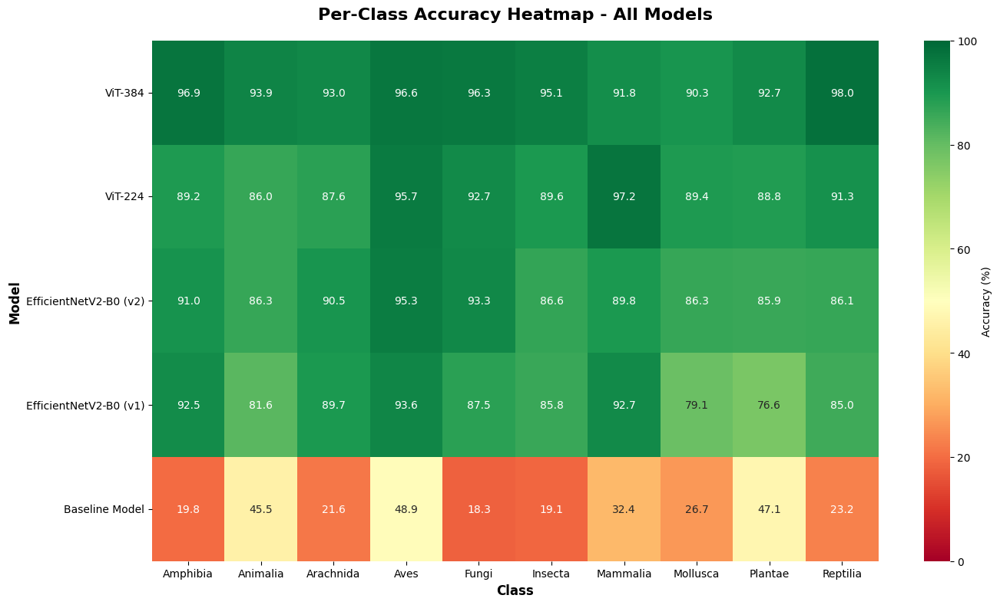

In [92]:
compare_models_summary(all_results, class_names)

# Plot comparison charts
plot_model_comparison(all_results)


In [93]:
# =====================================================
# Find common misclassifications across models
# =====================================================
def find_common_misclassifications(all_misclassified, class_names):
    """
    Identifies images that are misclassified by multiple models.

    Args:
        all_misclassified: Dictionary of misclassified data for all models
        class_names: List of class names
    """
    print("\n" + "="*80)
    print("COMMON MISCLASSIFICATIONS ANALYSIS")
    print("="*80)

    # This is a simplified version - in practice you'd need to track image indices
    # to identify the exact same images across models

    for model_name, data in all_misclassified.items():
        print(f"\n{model_name}: {len(data['images'])} misclassified images")

        # Count misclassifications by true class
        true_class_counts = {}
        for true_label in data['true_labels']:
            class_name = class_names[true_label]
            true_class_counts[class_name] = true_class_counts.get(class_name, 0) + 1

        print("  Most commonly misclassified true classes:")
        sorted_classes = sorted(true_class_counts.items(), key=lambda x: x[1], reverse=True)
        for class_name, count in sorted_classes[:5]:
            print(f"    {class_name}: {count} images")


# Execute common misclassifications analysis
find_common_misclassifications(all_misclassified, class_names)


COMMON MISCLASSIFICATIONS ANALYSIS

ViT-384: 53 misclassified images
  Most commonly misclassified true classes:
    Mollusca: 11 images
    Mammalia: 8 images
    Insecta: 6 images
    Arachnida: 5 images
    Plantae: 5 images

ViT-224: 83 misclassified images
  Most commonly misclassified true classes:
    Animalia: 12 images
    Amphibia: 11 images
    Mollusca: 11 images
    Arachnida: 10 images
    Plantae: 10 images

EfficientNetV2-B0 (v2): 111 misclassified images
  Most commonly misclassified true classes:
    Insecta: 17 images
    Mollusca: 15 images
    Animalia: 14 images
    Plantae: 13 images
    Mammalia: 11 images

EfficientNetV2-B0 (v1): 134 misclassified images
  Most commonly misclassified true classes:
    Mollusca: 22 images
    Plantae: 20 images
    Animalia: 19 images
    Insecta: 17 images
    Reptilia: 14 images

Baseline Model: 719 misclassified images
  Most commonly misclassified true classes:
    Insecta: 94 images
    Fungi: 86 images
    Mollusca: 84 im


VIEWING MISCLASSIFIED IMAGES

Viewing misclassifications for: ViT-384


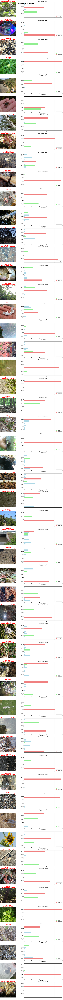

In [105]:
# View misclassified images for each model
print("\n" + "="*80)
print("VIEWING MISCLASSIFIED IMAGES")
print("="*80)
view_model_misclassifications('ViT-384', all_misclassified, class_names, page_number=0, images_per_page=100)